## **Demo Notebook**

This quick notebook will show how to

* load config
* create the dataset
* make a model
* load pretrained weights

This notebook should be run directly from the `scripts/` directory.

### **Config**

Make sure to change the following paths
* `DATASET_DIR`
* `LABELS_DIR`

STATIC = ['lane', 'road_segment']
DIVIDER = ['road_divider', 'lane_divider']
DYNAMIC = [
    'car', 'truck', 'bus',
    'trailer', 'construction',
    'pedestrian',
    'motorcycle', 'bicycle',
]

In [1]:
from hydra import core, initialize, compose
from omegaconf import OmegaConf
from cross_view_transformer.common import setup_experiment, load_backbone
import torch
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
import time
import imageio
import cv2 
from copy import deepcopy
DATASET_DIR = '/media/user/data4/nuscenes_data/'
def prepare_val(cfg,device,CHECKPOINT_PATH):
    core.global_hydra.GlobalHydra.instance().clear()        # required for Hydra in notebooks
    initialize(config_path='../config')
    OmegaConf.resolve(cfg)
    print(list(cfg.keys()))
    model, data, viz = setup_experiment(cfg)
    
    # Additional splits can be added to cross_view_transformer/data/splits/nuscenes/
    SPLIT = 'val_qualitative_000'
    SUBSAMPLE = 5
#     SUBSAMPLE_L = range(0, 20*SUBSAMPLE)
    # load dataset
    if True:
        dataset = data.get_split(SPLIT, loader=False)
        dataset = torch.utils.data.ConcatDataset(dataset)
        SUBSAMPLE_L = range(0, len(dataset), SUBSAMPLE)
        dataset = torch.utils.data.Subset(dataset, SUBSAMPLE_L)
        loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=False, num_workers=2)

    # Load all val dataset
    else:
        dataset = data.get_split('val', loader=False)
        dataset = torch.utils.data.ConcatDataset(dataset)
        loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=False, num_workers=5)

    print(len(dataset))
    # CE: 0323_222119, BE: 0314_172006, fuse: 0329_120028 fuse_ce: 0329_014003 fusion: 0421_022155, origin: 0421_101007 add: 0424_215017 topology:0504_171121
    if CHECKPOINT_PATH is not None:
        if Path(CHECKPOINT_PATH).exists():
            network = load_backbone(CHECKPOINT_PATH,device=device)
    else:
        network = model.backbone
    return model, network, loader, viz, dataset

def get_cfg(LABELS_DIR,exp):
    core.global_hydra.GlobalHydra.instance().clear()    
    initialize(config_path='../config')
    cfg = compose(
        config_name='config',
        overrides=[
            'experiment.save_dir=../logs/',                
            f'+experiment={exp}',
            f'data.dataset_dir={DATASET_DIR}',
            f'data.labels_dir={LABELS_DIR}',
            'data.version=v1.0-trainval',
            'loader.batch_size=1',
#             '+model.radar=True',
        ]
    )
    return cfg

def calculate_iou(model,network,loader):
    device_2 = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')
    device = torch.device('cuda:2' if torch.cuda.is_available() else 'cpu')
    metrics_name = ['DIVIDER','STATIC','PED','VEHICLE']
    for k,m in model.metrics.items():
        m.thresholds = m.thresholds.to(device_2)
        m.tp = m.tp.to(device_2)
        m.fp = m.fp.to(device_2)
        m.fn = m.fn.to(device_2)

    network.to(device)
    network.eval()

    with torch.no_grad():
        for i,batch in enumerate(loader):
    #         start = time.time()
            print(i,end='\r')
            for k, v in batch.items():
                if k!='features' or k!='center':
                    if isinstance(v, torch.Tensor):
                        batch[k] = v.to(device)
                    else:
                        batch[k] = v
            pred = network(batch)
            pred = {k: v.to(device_2) for k, v in pred.items()}
            batch['bev'] = batch['bev'].to(device_2)
            batch['visibility'] = batch['visibility'].to(device_2)
            batch['visibility_ped'] = batch['visibility_ped'].to(device_2)
            model.metrics.update(pred,batch)
    print()
    for k,m in model.metrics.items():
        print(k,m.compute(),end='\n=========================\n')

In [2]:
CHECKPOINT_PATH = None
device = torch.device('cpu')
# cfg1 = get_cfg('/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v5','instance_radar',fuse_in=0,num_classes=12)
# model1, network1, loader1, viz1 = prepare_val(cfg1,device,'../logs/cross_view_transformers_test/0525_040606/checkpoints/last.ckpt')
cfg1 = get_cfg('/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v8','radar_stream_fusion') # cvt_nuscenes_multiclass
device = torch.device('cuda:0')
CHECKPOINT_PATH = '../logs/cross_view_transformers_test/0710_192315/checkpoints/last.ckpt'
model1, network1, loader1, viz1, dataset1 = prepare_val(cfg1,device,CHECKPOINT_PATH)

['experiment', 'loader', 'optimizer', 'scheduler', 'trainer', 'model', 'data', 'visualization', 'loss', 'metrics']
Loaded pretrained weights for efficientnet-b4
torch.Size([1, 48, 112, 240])
torch.Size([1, 32, 56, 120])
torch.Size([1, 56, 28, 60])
torch.Size([1, 112, 14, 30])


BaseException: 

In [9]:
calculate_iou(model1, network1, loader1)

1203
iou_vehicle {'@0.40': 0.41727498173713684, '@0.50': 0.41266632080078125, '@0.60': 0.3918253183364868}


In [ ]:
network1 = network1.eval()
with torch.no_grad():
    batch = dataset1.__getitem__(5143)
    for k,v in batch.items():
        if isinstance(v,torch.Tensor):
            batch[k] = v[None]
    # batch = {k:v[None] if isinstance(v,torch.Tensor) else k:v for k,v in batch.items()}
    pred = network1(batch)
    # plt.imshow(visualize(batch,pred['bev'][0].sigmoid()))
plt.imshow(pred['bev'][0,0].sigmoid(),cmap='inferno')

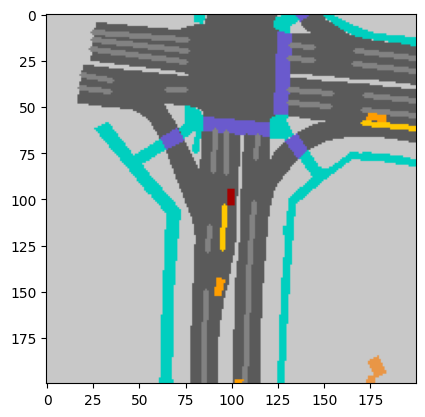

In [15]:
plt.imshow(visualize_bev(batch['bev'],batch['view'][0].cpu().numpy()))

In [6]:
device_2 = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')
device = torch.device('cuda:2' if torch.cuda.is_available() else 'cpu')
for k,m in model1.metrics.items():
    m.thresholds = m.thresholds.to(device_2)
    m.tp = m.tp.to(device_2)
    m.fp = m.fp.to(device_2)
    m.fn = m.fn.to(device_2)
    
root = '/media/user/data4/TommyLu/cross_view_transformers/failure_case'
network1.to(device)
network1.eval()
below_average = list()
below_count = 0
with torch.no_grad():
    for i,batch in enumerate(loader1):
#         start = time.time()
        print(i,below_count,end='\r')
        for k, v in batch.items():
            if k!='features' or k!='center':
                if isinstance(v, torch.Tensor):
                    batch[k] = v.to(device)
                else:
                    batch[k] = v
        pred = network1(batch)
        pred = {k: v.to(device_2) for k, v in pred.items()}
        batch['bev'] = batch['bev'].to(device_2)
        batch['visibility'] = batch['visibility'].to(device_2)
        batch['visibility_ped'] = batch['visibility_ped'].to(device_2)
        model1.metrics.update(pred,batch)
        for k,m in model1.metrics.items():
            iou = m.compute()
            if iou['@0.40']<0.418:
                if iou['@0.40']==0.0:
                    continue
#                 below_average.append({'pred':pred,'batch':batch,'id':i})
                cv2.imwrite(f"{root}/{below_count:04d}_{i}.png",visualize(batch,pred['bev'][0].sigmoid())[...,::-1])
                below_count += 1
            m.reset()

In [6]:
for k,m in model1.metrics.items():
    m.reset()

In [3]:
raw = list()
pred = list()
network1.to(device)
network1.eval()
with torch.no_grad():
    for i,batch in enumerate(loader1):
        print(i,end='\r')
        for k, v in batch.items():
            if k!='features' or k!='center':
                if isinstance(v, torch.Tensor):
                    batch[k] = v.to(device)
                else:
                    batch[k] = v
        raw.append(batch)
#         pred.append(network1(batch,inspect=True))
        #batch_l.append(visualize(batch))

In [4]:
def draw_features(tensor,index=0,modality_list = None, cmap='inferno'):
    nrow, ncol = 4,4
    figsize = (20,20)
    if isinstance(modality_list,list):
        nrow = len(modality_list)
        figsize = (18,12)
    fig, ax = plt.subplots(nrow,ncol,figsize=figsize)
    count = 16*index
    if isinstance(modality_list,list):
        for i, s in enumerate(modality_list):
            count = 4*index
            for j in range(ncol):
                features_map = torch.nn.functional.interpolate(tensor[s][0,count][None,None].sigmoid(),(200,200))
                ax[i,j].imshow(features_map[0,0].cpu().numpy(),cmap=cmap) # torch.nn.functional.adaptive_avg_pool2d(d,(200,200))
                ax[i,j].axis('off')
                ax[i,j].title.set_text(f"{s}: {count}")
                count += 1
    else:
        for i in range(nrow):
            for j in range(ncol):
                ax[i,j].imshow(tensor[0,count].sigmoid().cpu().numpy(),cmap=cmap) # torch.nn.functional.adaptive_avg_pool2d(d,(200,200))
                ax[i,j].axis('off')
                ax[i,j].title.set_text(f"{count}")
                count += 1
    plt.show()

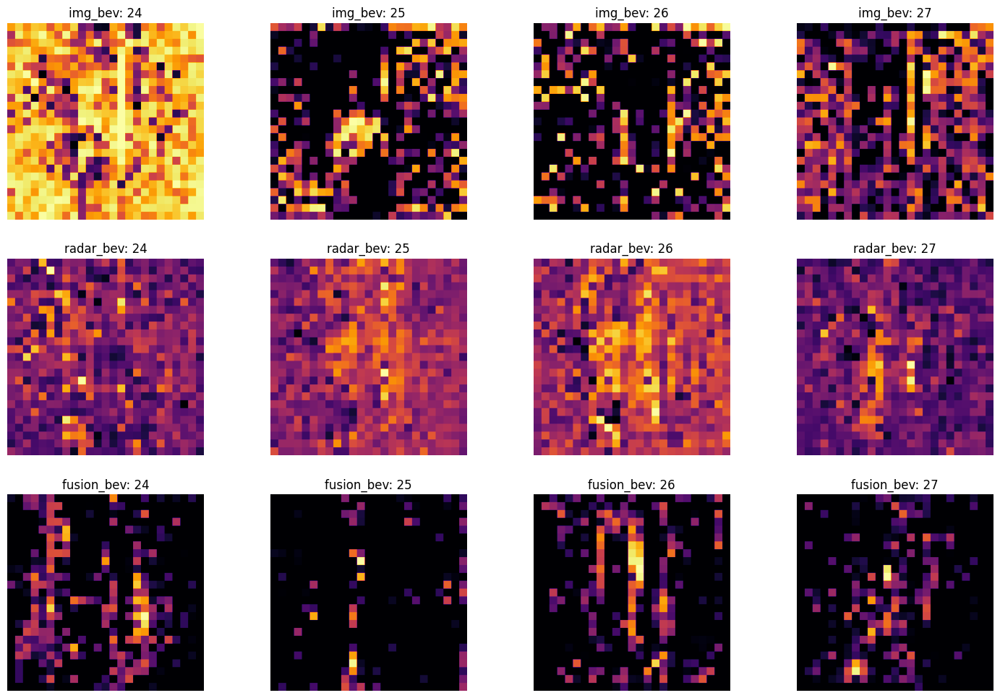

In [5]:
index = 14
draw_features(pred[index][1],modality_list=['img_bev','radar_bev','fusion_bev'],index=6)

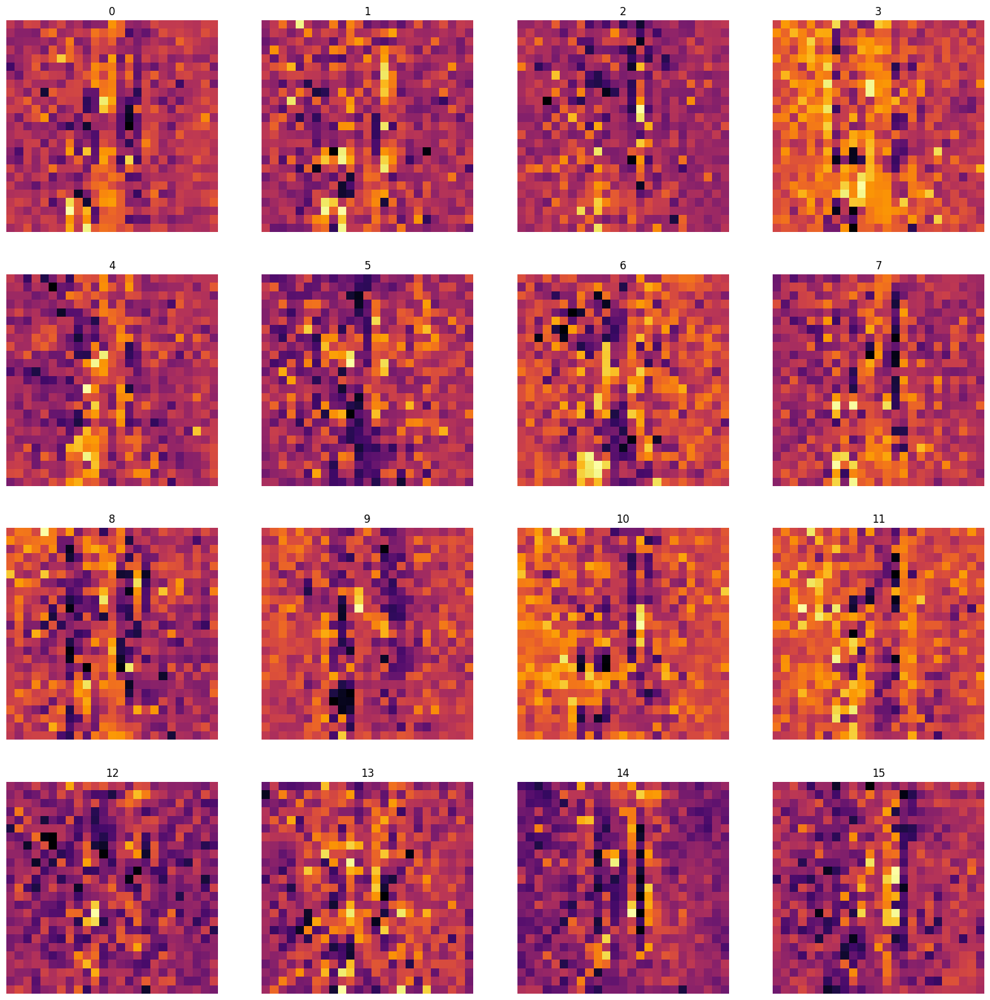

In [6]:
draw_features(pred[index][1]['radar_bev'],index=0)

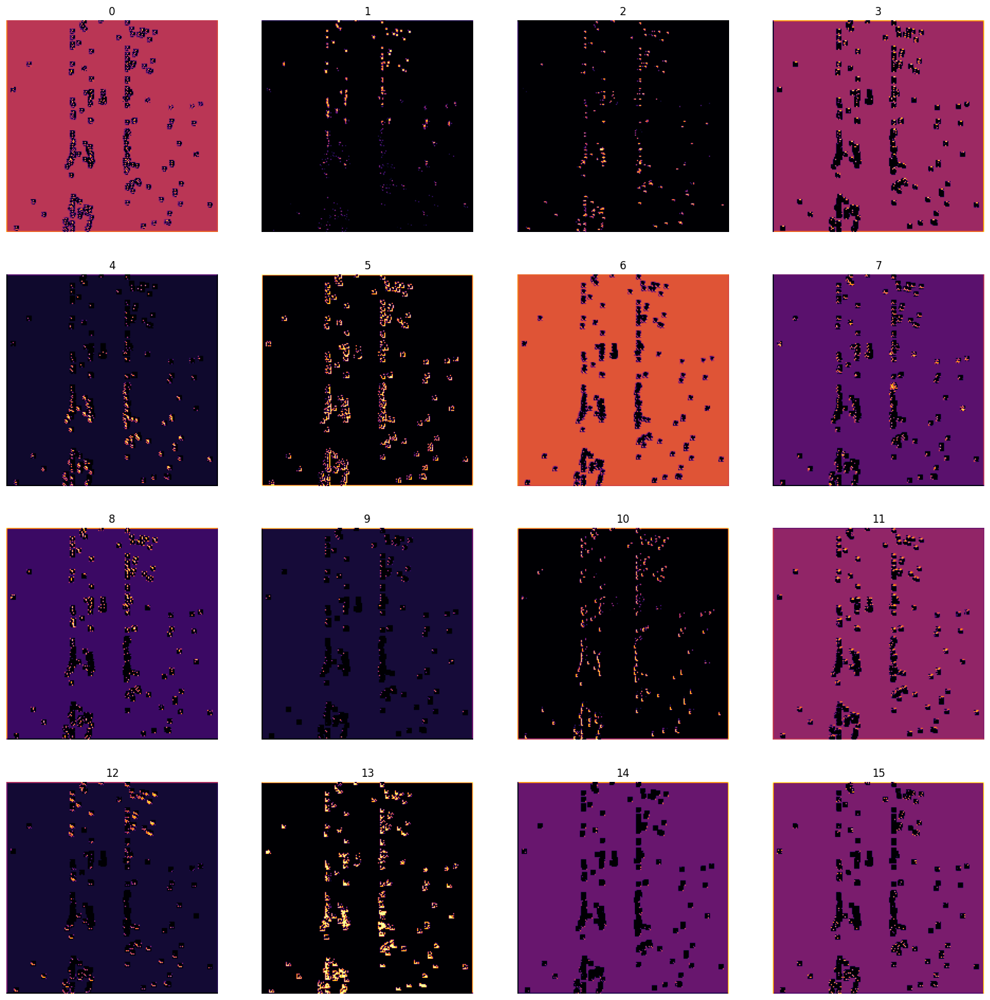

In [7]:
draw_features(pred[index][1]['radar_features'],index=0)

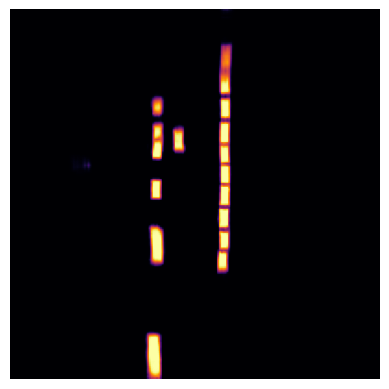

In [8]:
plt.imshow(pred[index][0]['bev'].sigmoid()[0,0].cpu().numpy(),cmap='inferno')
# plt.imshow(pred[index][1]['radar_features'].sigmoid()[0,0].cpu().numpy(),alpha=0.5,cmap='inferno')
# plt.imshow(raw[index]['radar'].sigmoid()[0,0].cpu().numpy(),alpha=0.5,cmap='inferno')
plt.axis('off')
plt.show()

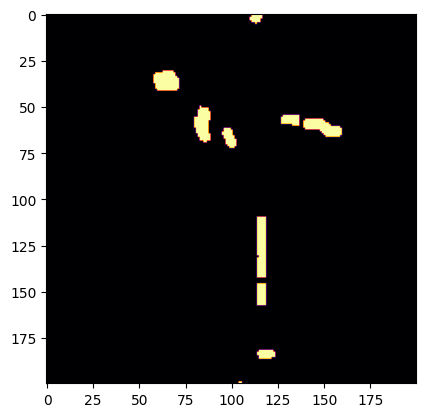

In [96]:
plt.imshow((below_average[1]['pred']['bev'][0,0].sigmoid()>0.4).cpu().numpy(),cmap='inferno')

In [84]:
for j in range(len(raw)):
    imgs = [to_image(raw[j]['image'][0,i]) for i in range(6)]
    a = np.hstack(imgs[:3])
    b = np.hstack(imgs[3:])
    result = np.vstack((a, b))
    cv2.imshow('video',result)
    cv2.waitKey(500)
cv2.destroyAllWindows()

QObject::moveToThread: Current thread (0x774d7c0) is not the object's thread (0x186a11890).
Cannot move to target thread (0x774d7c0)

QObject::moveToThread: Current thread (0x774d7c0) is not the object's thread (0x186a11890).
Cannot move to target thread (0x774d7c0)

QObject::moveToThread: Current thread (0x774d7c0) is not the object's thread (0x186a11890).
Cannot move to target thread (0x774d7c0)

QObject::moveToThread: Current thread (0x774d7c0) is not the object's thread (0x186a11890).
Cannot move to target thread (0x774d7c0)

QObject::moveToThread: Current thread (0x774d7c0) is not the object's thread (0x186a11890).
Cannot move to target thread (0x774d7c0)

QObject::moveToThread: Current thread (0x774d7c0) is not the object's thread (0x186a11890).
Cannot move to target thread (0x774d7c0)

QObject::moveToThread: Current thread (0x774d7c0) is not the object's thread (0x186a11890).
Cannot move to target thread (0x774d7c0)

QObject::moveToThread: Current thread (0x774d7c0) is not the o

AttributeError: module 'cv2' has no attribute 'DestroyAllWindow'

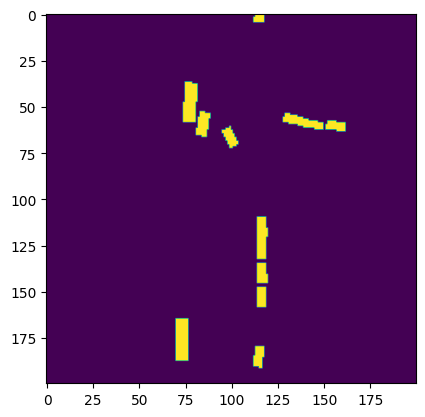

In [29]:
# plt.imshow(visualize_bev(raw[10]['bev']))
plt.imshow((raw[10]['visibility'][0]==4).cpu())
# raw[10]['visibility'].shape

In [83]:
root = '/media/user/data4/TommyLu/cross_view_transformers/failure_case'
for i in range(len(below_average)):
#     plt.imshow(visualize(below_average[i]['batch'],below_average[i]['pred']['bev'][0].sigmoid()))
#     plt.axis('off')
#     plt.savefig(f"{root}/{i}")
    cv2.imwrite(f"{root}/{i:02d}_{below_average[i]['id']}.png",visualize(below_average[i]['batch'],below_average[i]['pred']['bev'][0].sigmoid())[...,::-1])

In [8]:
cfg1 = get_cfg('/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v4','divider_fusion',fuse_in=512,num_classes=17)
cfg2 = get_cfg('/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v3','cvt_nuscenes_multiclass_fusion')

model1, network1, loader1, viz1 = prepare_val(cfg1,'../logs/cross_view_transformers_test/0514_014909/checkpoints/last.ckpt')
model2, network2, loader2, viz2 = prepare_val(cfg2,'../logs/cross_view_transformers_test/0421_101007/checkpoints/last.ckpt')

['experiment', 'loader', 'optimizer', 'scheduler', 'trainer', 'model', 'data', 'visualization', 'loss', 'metrics']
Loaded pretrained weights for efficientnet-b4
49
Loaded pretrained weights for efficientnet-b4
['experiment', 'loader', 'optimizer', 'scheduler', 'trainer', 'model', 'data', 'visualization', 'loss', 'metrics']
Loaded pretrained weights for efficientnet-b4
49
Loaded pretrained weights for efficientnet-b4


In [5]:
from cross_view_transformer.data.instance import predict_instance_segmentation_and_trajectories
COLORS = {
    # static
    'lane':                 (110, 110, 110), #0
    'road_segment':         (90, 90, 90),#1

    # dividers
    'road_divider':         (255, 200, 0),#2
    'lane_divider':         (130, 130, 130),#3

    # dynamic
    'car':                  (255, 158, 0),#4
    'truck':                (255, 99, 71),#5
    'bus':                  (255, 127, 80),#6
    'trailer':              (255, 140, 0),#7
    'construction':         (233, 150, 70),#8
    'pedestrian':           (0, 0, 230),#9
    'motorcycle':           (255, 61, 99),#10
    'bicycle':              (220, 20, 60),#11
    'emergency':                (34, 139, 34),
    'ped_crossing':                    (106, 90, 205),#12
    'walkway':                (0, 207, 191),#13
    'carpark_area':                (34, 139, 34),#14
    'DRIVABLE':               (166, 206, 227),
    'PED':                    (106, 90, 205),
    'WALKWAY':                (0, 207, 191),
    'CARPARK':                (34, 139, 34),
    'STOPLINE':               (138, 43, 226),
    'nothing':              (200, 200, 200),
    'ped': (0, 0, 230),
    'bev': (255, 158, 0),
    'DIVIDER': (255, 200, 0),
    'STATIC': (110, 110, 110)
}
COLORS_list = [COLORS[v] for v in COLORS]
def to_image(x):
    return (255 * x).byte().cpu().numpy().transpose(1, 2, 0)

def resize(src, dst=None, shape=None, idx=0):
    if dst is not None:
        ratio = dst.shape[idx] / src.shape[idx]
    elif shape is not None:
        ratio = shape[idx] / src.shape[idx]

    width = int(ratio * src.shape[1])
    height = int(ratio * src.shape[0])

    return cv2.resize(src, (width, height), interpolation=cv2.INTER_CUBIC)

def visualize_bev(bev1,view,bev2=None,index=[0,1,13,14,2,3,4,5,6,7,8,9,10,11,12]):
    if isinstance(bev1, torch.Tensor):
        if bev1.shape[0] == 1:
            bev1 = bev1[0]
        bev1 = bev1.cpu().numpy().transpose(1, 2, 0)
    if isinstance(bev2, torch.Tensor):
        if bev2.shape[0] == 1:
            bev2 = bev2[0]
        bev2 = bev2.cpu().numpy().transpose(1, 2, 0)
    bev = bev1
    # Prioritize higher class labels
    # index = [0,1,15,13,14,16,2,3,4,5,6,7,8,9,10,11]
#     index = [0,1,2]
    c_list = np.array([COLORS_list[i] for i in index], dtype=np.uint8)
    bev_new = np.empty((200,200,0))
    for i in index:
        bev_new = np.concatenate((bev_new,np.array(bev[:,:,i][:,:,None])),2)
    eps = (1e-2 * np.arange(bev_new.shape[-1]))[None, None]
    idx = (bev_new + eps).argmax(axis=-1)

    # idx = (torch.tensor([c-1]).expand(h,w).type(torch.int64)).numpy()

    val = np.take_along_axis(bev_new, idx[..., None], -1)

    # Spots with no labels are light grey
    empty = np.uint8(COLORS['nothing'])[None, None]

    result = (val * c_list[idx]) + ((1 - val) * empty)
    result = np.uint8(result)
    points = np.array([
            [-4.0 / 2 + 0.3, -1.73 / 2, 1],
            [-4.0 / 2 + 0.3,  1.73 / 2, 1],
            [ 4.0 / 2 + 0.3,  1.73 / 2, 1],
            [ 4.0 / 2 + 0.3, -1.73 / 2, 1],
        ])

    points = view @ points.T
    cv2.fillPoly(result, [points.astype(np.int32)[:2].T], color=(164, 0, 0))
    return result

def visualize_instance(pred,batch,flip=False,center_threshold=0.6):
    # prepare instance
    out = {'vehicle':pred['vehicle'].sigmoid(),'instance_center':pred['center'],'instance_offset':pred['offset']}
    instance_out = predict_instance_segmentation_and_trajectories(out,threshold=0.5,center_threshold=0.6)
    canvas = np.ones((200,200,3)).astype(np.uint8)*200
    # draw topology first
    for i in range(4):
        mask = (batch['bev'][0][i] == 1).cpu().numpy()
        canvas[mask] = COLORS_list[i]
    m = instance_out.max()
    color = np.random.choice(range(256), size=(m,3))
    for i in range(1,m+1):
        mask = (instance_out[0,0] == i).cpu().numpy()
        canvas[mask] = color[i-1]
        
    points = np.array([
            [-4.0 / 2 + 0.3, -1.73 / 2, 1],
            [-4.0 / 2 + 0.3,  1.73 / 2, 1],
            [ 4.0 / 2 + 0.3,  1.73 / 2, 1],
            [ 4.0 / 2 + 0.3, -1.73 / 2, 1],
        ])
    if flip:
        tmp = np.array(points[:,0])
        points[:,0] = points[:,1]
        points[:,1] = tmp

    points = batch['view'][0].cpu().numpy() @ points.T


    cv2.fillPoly(canvas, [points.astype(np.int32)[:2].T], color=(164, 0, 0))
    return [canvas]

def visualize_custom(pred1,view,pred2=None,threshold=0.4):
#     key1 = ['STATIC','PED','WALKWAY','CARPARK','DIVIDER']
#     key2 = ['bev','ped']
#     key = key1+key2
#     if pred2 is not None:
#         tmp = [pred2['STATIC'][0].sigmoid()]
#     else:
#         tmp = []
#     for k in key1[1:]:
#         tmp.append(pred1[k][0].sigmoid())
#     if pred2 is not None: 
#         for k in key2:
#             tmp.append(pred2[k][0].sigmoid())
#     pred = torch.cat(tmp,dim=0)
    key = ['bev']
    pred = pred1
    pred[pred>=threshold]=1
    pred[pred<threshold]=0
    pre=torch.zeros(200,200,3).type(torch.uint8)
    pre+=200
    for i,k in enumerate(key):
        pre[...,0][pred[i]==1]=COLORS[k][0]
        pre[...,1][pred[i]==1]=COLORS[k][1]
        pre[...,2][pred[i]==1]=COLORS[k][2]

    pre = pre.cpu().numpy()
    pre = pre.astype(np.uint8)

    points = np.array([
            [-4.0 / 2 + 0.3, -1.73 / 2, 1],
            [-4.0 / 2 + 0.3,  1.73 / 2, 1],
            [ 4.0 / 2 + 0.3,  1.73 / 2, 1],
            [ 4.0 / 2 + 0.3, -1.73 / 2, 1],
        ])

    points = view @ points.T


    cv2.fillPoly(pre, [points.astype(np.int32)[:2].T], color=(164, 0, 0))
    return [pre]

def visualize(batch1,pred1=None,batch2=None,pred2=None,instance=False):
    b = 0
    bev1 = batch1['bev']
    view = batch1['view'][0].cpu().numpy()
    if batch2 is not None:
        bev2 = batch2['bev']
        view = batch2['view'][0].cpu().numpy()
        right = visualize_bev(bev1[0],bev2[0])
    else:
        right = visualize_bev(bev1[0],view,index=[i for i in range(13)])
    if pred1 is not None:
        if instance:
            right = [right] + visualize_instance(pred1,batch1,flip=True)
        else:
            right = [right] + visualize_custom(pred1,view,pred2,0.4)
    else:
        right = [right]
    right = [x for x in right if x is not None]
    right = np.hstack(right)
    if batch2 is not None:
        image = None if not hasattr(batch2.get('image'), 'shape') else batch2['image']
    else:
        image = None if not hasattr(batch1.get('image'), 'shape') else batch1['image']

    if image is not None:
        imgs = [to_image(image[b][i]) for i in range(image.shape[1])]

        if len(imgs) == 6:
            a = np.hstack(imgs[:3])
            b = np.hstack(imgs[3:])
            left = resize(np.vstack((a, b)), right)
        else:
            left = np.hstack([resize(x, right) for x in imgs])

        return np.hstack((left, right))

In [9]:
device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')
GIF_PATH = './predictions_focal_fusion.gif'
network1.to(device)
network1.eval()
network2.to(device)
network2.eval()

images = list()
with torch.no_grad():
    for i,batchs in enumerate(zip(loader1,loader2)):
        print(i,end='\r')
        batch1, batch2 = batchs
        batch1 = {k: v.to(device) if isinstance(v, torch.Tensor) else v for k, v in batch1.items()}
        batch2 = {k: v.to(device) if isinstance(v, torch.Tensor) else v for k, v in batch2.items()}
        
        pred1 = network1(batch1)
        pred2 = network2(batch2)
        img = visualize(batch1,batch2,pred1,pred2)
        images.append(img)
        
duration = [1 for _ in images[:-1]] + [5 for _ in images[-1:]]
imageio.mimsave(GIF_PATH, images, duration=duration)

In [10]:
for i,img in enumerate(images):
    cv2.imwrite('../topology1/'+ str(i) + '.jpg',img[...,::-1])

In [1]:
from hydra import core, initialize, compose
from omegaconf import OmegaConf
from cross_view_transformer.common import setup_experiment, load_backbone
import torch
import matplotlib.pyplot as plt
import numpy as np

DATASET_DIR = '/media/user/data4/nuscenes_data/'
# v4: topology, v5: radar
LABELS_DIR = '/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v6'


core.global_hydra.GlobalHydra.instance().clear()        # required for Hydra in notebooks

initialize(config_path='../config')

# Add additional command line overrides"
cfg = compose(
    config_name='config',
    overrides=[
        'experiment.save_dir=../logs/',                 # required for Hydra in notebooks
#         '+experiment=cvt_nuscenes_multiclass',
#         '+experiment=cvt_nuscenes_VP_fusion',
#         '+experiment=cvt_nuscenes_multiclass_fusion',
        '+experiment=radar_stream_fusion',
#         '+visualization.is_ce=True',
        f'data.dataset_dir={DATASET_DIR}',
        f'data.labels_dir={LABELS_DIR}',
        'data.version=v1.0-trainval',
        'loader.batch_size=5',
        #'+model.ablation=1', # 1:origin, 2: add
    ]
)

# resolve config references
OmegaConf.resolve(cfg)

print(list(cfg.keys()))

model, data, viz = setup_experiment(cfg)

['experiment', 'loader', 'optimizer', 'scheduler', 'trainer', 'model', 'data', 'visualization', 'loss', 'metrics']
Loaded pretrained weights for efficientnet-b4


In [2]:
# Additional splits can be added to cross_view_transformer/data/splits/nuscenes/
SPLIT = 'val_qualitative_000'
SUBSAMPLE = 5


# load dataset
if False:
    dataset = data.get_split(SPLIT, loader=False)
    dataset = torch.utils.data.ConcatDataset(dataset)
    dataset = torch.utils.data.Subset(dataset, range(0, len(dataset), SUBSAMPLE))
    loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=False, num_workers=2)

# Load all val dataset
else:
    dataset = data.get_split('val', loader=False)
    dataset = torch.utils.data.ConcatDataset(dataset)
    loader = torch.utils.data.DataLoader(dataset, batch_size=5, shuffle=False, num_workers=5)


print(len(dataset))

6019


In [3]:
from pathlib import Path


# Download a pretrained model (13 Mb)
MODEL_URL = 'https://www.cs.utexas.edu/~bzhou/cvt/cvt_nuscenes_vehicles_50k.ckpt'

# CE: 0323_222119, BE: 0314_172006, fuse: 0329_120028 fuse_ce: 0329_014003 fusion: 0421_022155, origin: 0421_101007 add: 0424_215017 topology:0504_171121
CHECKPOINT_PATH = '../logs/cross_view_transformers_test/0704_180846/checkpoints/last.ckpt'
#'../logs/cvt_nuscenes_vehicles_50k.ckpt'

# !wget $MODEL_URL -O $CHECKPOINT_PATH


if Path(CHECKPOINT_PATH).exists():
    network = load_backbone(CHECKPOINT_PATH)
else:
    network = model.backbone

    print(f'{CHECKPOINT_PATH} not found. Using randomly initialized weights.')

Loaded pretrained weights for efficientnet-b4


In [4]:
import torch
import time
import imageio
import ipywidgets as widgets
import cv2 
import matplotlib.pyplot as plt

device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')


network.to(device)
network.eval()

images = list()
with torch.no_grad():
    for i,batch in enumerate(loader):
        print(i,end='\r')
        batch = {k: v.to(device) if isinstance(v, torch.Tensor) else v for k, v in batch.items()}
        pred = network(batch)
        visualization = np.vstack(viz(batch=batch, pred=pred))
        images.append(visualization)

torch.Size([1, 79, 200, 200])
torch.Size([1, 64, 200, 200])


BaseException: 

In [7]:
# origin
# DIVIDER {'@0.40': 0.10891163349151611, '@0.50': 0.03684411197900772, '@0.60': 0.005121578462421894}
# STATIC {'@0.40': 0.7174161076545715, '@0.50': 0.7185003161430359, '@0.60': 0.6772728562355042}
# PED {'@0.40': 0.1285427212715149, '@0.50': 0.06109368056058884, '@0.60': 0.009474036283791065}
# VEHICLE {'@0.40': 0.33643797039985657, '@0.50': 0.3058546185493469, '@0.60': 0.19889822602272034}

# fusion
# DIVIDER {'@0.40': 0.10110945999622345, '@0.50': 0.03491298109292984, '@0.60': 0.006345569621771574}
# STATIC {'@0.40': 0.6623843908309937, '@0.50': 0.661169171333313, '@0.60': 0.5850088000297546}
# PED {'@0.40': 0.15915894508361816, '@0.50': 0.12008305639028549, '@0.60': 0.049785081297159195}
# VEHICLE {'@0.40': 0.3675220310688019, '@0.50': 0.352006196975708, '@0.60': 0.25983190536499023}

# DIVIDER {'@0.40': 0.13568271696567535, '@0.50': 0.054101742804050446, '@0.60': 0.008489863015711308}
# STATIC {'@0.40': 0.6354442238807678, '@0.50': 0.6934921145439148, '@0.60': 0.6860349774360657}
# PED {'@0.40': 0.5306078195571899, '@0.50': 0.47720441222190857, '@0.60': 0.34877896308898926}
# VEHICLE {'@0.40': 0.6578018665313721, '@0.50': 0.6503700017929077, '@0.60': 0.5772817134857178}
metrics = [model.metrics.iou_DIVIDER,
model.metrics.iou_STATIC,
model.metrics.iou_ped,
model.metrics.iou_vehicle]
metrics_name = ['divider','static','ped','vehicle']
# model.metrics.iou_with_occlusions]
# model.metrics.iou_with_occlusions]
for m,s in zip(metrics,metrics_name):
    print(s,m.compute())

divider {'@0.10': 0.049848444759845734, '@0.15': 0.06570527702569962, '@0.20': 0.08607231080532074, '@0.25': 0.11093422025442123, '@0.30': 0.13872548937797546, '@0.35': 0.15177065134048462, '@0.40': 0.14192916452884674, '@0.45': 0.1130322813987732, '@0.50': 0.07482443749904633}
static {'@0.10': 0.5018134713172913, '@0.15': 0.5554302334785461, '@0.20': 0.5979358553886414, '@0.25': 0.6326271891593933, '@0.30': 0.6612478494644165, '@0.35': 0.6845932602882385, '@0.40': 0.7010875940322876, '@0.45': 0.7085244655609131, '@0.50': 0.7045799493789673}
ped {'@0.10': 0.035644009709358215, '@0.15': 0.05611220374703407, '@0.20': 0.079070083796978, '@0.25': 0.10416559129953384, '@0.30': 0.12623752653598785, '@0.35': 0.1371726244688034, '@0.40': 0.12399872392416, '@0.45': 0.09093858301639557, '@0.50': 0.05336010083556175}
vehicle {'@0.10': 0.09667707979679108, '@0.15': 0.13949702680110931, '@0.20': 0.1866406947374344, '@0.25': 0.23253513872623444, '@0.30': 0.27432700991630554, '@0.35': 0.3067566752433

In [5]:
import torch
import time
import imageio
import ipywidgets as widgets


GIF_PATH = './predictions_focal_fusion.gif'


# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

network.to(device)
network.eval()

images = list()

with torch.no_grad():
    for i,batch in enumerate(loader):
        print(i,end='\r')
        batch = {k: v.to(device) if isinstance(v, torch.Tensor) else v for k, v in batch.items()}
        pred = network(batch)

        visualization = np.vstack(viz(batch=batch, pred=pred,threshold=0.4))

        images.append(visualization)


# Save a gif
duration = [1 for _ in images[:-1]] + [5 for _ in images[-1:]]
imageio.mimsave(GIF_PATH, images, duration=duration)

# html = f'''
# <div align="center">
# <img src="{GIF_PATH}?modified={time.time()}" width="80%">
# </div>
# '''

# display(widgets.HTML(html))

In [10]:
import cv2
for i,img in enumerate(images):
    cv2.imwrite('../img_outs_last1/'+ str(i) + '.jpg',img[...,::-1])
# cv2.imshow('My Image', images[0][...,::-1])

# # 按下任意鍵則關閉所有視窗
# cv2.waitKey(0)
# cv2.destroyAllWindows()

In [11]:

param_size = 0
for param in network.parameters():
    param_size += param.nelement() * param.element_size()
buffer_size = 0
for buffer in network.buffers():
    buffer_size += buffer.nelement() * buffer.element_size()

size_all_mb = (param_size + buffer_size) / 1024**2
print('model size: {:.3f}MB'.format(size_all_mb))

model size: 5.311MB


In [ ]:
import torch
import time
import imageio
import ipywidgets as widgets
import cv2 
import matplotlib.pyplot as plt



GIF_PATH = './multi_class_withoutlane.gif'

device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')

label_indices=[[9],[4,5,6,7,8,10,11],[2,3],[0,1]]

network.to(device)
network.eval()
count = torch.tensor([0.0]*5).to(device)

with torch.no_grad():
    for i,batch in enumerate(loader):
        label = batch['bev']
        for j,idx in enumerate(label_indices):
            if j == 0:
                label_new = label[:, idx].max(1, keepdim=True).values
            else:
                tmp_label = (label[:, idx].max(1, keepdim=True).values)
                mask = (~((label_new.long()>=1 )& (tmp_label.long()==1))).long()
                label_new += (tmp_label*mask)*(j+1)
        for j in range(5):
            count[j] += (label_new == j).sum()
        print(f"{i+1}/{len(dataset)}: none: {count[0]}, ped: {count[1]}, vehicle: {count[2]}, divider: {count[3]}, static: {count[4]}",end='\r')

In [ ]:
count[0]/count[1:]

In [ ]:
for m,s in zip(metrics,metrics_name):
    print(s,m.compute())

In [ ]:
model.metrics.iou_DIVIDER.tp

In [12]:
import torch
import time
import imageio
import ipywidgets as widgets
import cv2 
import matplotlib.pyplot as plt

device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')


network.to(device)
network.eval()

images = list()
with torch.no_grad():
    for i,batch in enumerate(loader):
        print(i,end='\r')
        batch = {k: v.to(device) if isinstance(v, torch.Tensor) else v for k, v in batch.items()}
        pred = network(batch)
        visualization = np.vstack(viz(batch=batch, pred=pred))
        images.append(visualization)

In [9]:
def decode_segmap(image, nc=5):
    label_colors = np.array([(200, 200, 200),(0, 0, 230),(255, 158, 0),(255, 200, 0),(110, 110, 110),])
    r = np.zeros_like(image).astype(np.uint8)
    g = np.zeros_like(image).astype(np.uint8)
    b = np.zeros_like(image).astype(np.uint8)
    for l in range(nc):
        idx = image == l
        r[idx] = label_colors[l, 0]
        g[idx] = label_colors[l, 1]
        b[idx] = label_colors[l, 2]
        rgb = np.stack([r, g, b], axis=0)
    return rgb.transpose(1,2,0)[...,::-1]

In [15]:
pred_2 = torch.cat((pred['STATIC'].sigmoid(),pred['DIVIDER'].sigmoid(),pred['bev'].sigmoid(),pred['ped'].sigmoid()),dim=1)
# pred_2 = torch.nn.functional.softmax(pred_2,dim=1)
pred_2 = (pred_2.argmax(dim=1))

In [ ]:
out = decode_segmap(label_new[0,0].cpu().numpy())
print(out.shape)

In [16]:
# out = decode_segmap(label_new.cpu().numpy()[0])
out = decode_segmap(pred_2[0].cpu().numpy())
print(out.shape)
cv2.imshow('My Image', out)

# 按下任意鍵則關閉所有視窗
cv2.waitKey(0)
cv2.destroyAllWindows()

(200, 200, 3)


QObject::moveToThread: Current thread (0xedfc8a60) is not the object's thread (0xf17a1c20).
Cannot move to target thread (0xedfc8a60)

QObject::moveToThread: Current thread (0xedfc8a60) is not the object's thread (0xf17a1c20).
Cannot move to target thread (0xedfc8a60)

QObject::moveToThread: Current thread (0xedfc8a60) is not the object's thread (0xf17a1c20).
Cannot move to target thread (0xedfc8a60)

QObject::moveToThread: Current thread (0xedfc8a60) is not the object's thread (0xf17a1c20).
Cannot move to target thread (0xedfc8a60)

QObject::moveToThread: Current thread (0xedfc8a60) is not the object's thread (0xf17a1c20).
Cannot move to target thread (0xedfc8a60)

QObject::moveToThread: Current thread (0xedfc8a60) is not the object's thread (0xf17a1c20).
Cannot move to target thread (0xedfc8a60)

QObject::moveToThread: Current thread (0xedfc8a60) is not the object's thread (0xf17a1c20).
Cannot move to target thread (0xedfc8a60)

QObject::moveToThread: Current thread (0xedfc8a60) is n

In [14]:
def draw_features(tensor,index):
    nrow, ncol = 4,4
    fig, ax = plt.subplots(nrow,ncol,figsize=(20,20))
    count = 16*index
    for i in range(ncol):
        for j in range(nrow):
            ax[i,j].imshow(tensor[count].cpu()) # torch.nn.functional.adaptive_avg_pool2d(d,(200,200))
            ax[i,j].axis('off')
            ax[i,j].title.set_text(str(count))
            count += 1
    plt.show()

def read_img(img_files,read=True):
    plt.figure(figsize=(10,20))
    if read:
        for i in range(len(img_files)):
            img_files[i] = plt.imread(img_files[i])            
    top = img_files[0]
    for i in range(2):
        top = np.concatenate((top,img_files[i+1]),axis=1)
    bottom = img_files[-1]
    # bottom = np.concatenate((bottom,np.fliplr(plt.imread(img_files[-2]))),axis=1)
    bottom = np.concatenate((bottom,img_files[-2]),axis=1)
    bottom = np.concatenate((bottom,img_files[-3]),axis=1)

    out = np.concatenate((top,bottom),axis=0)
    plt.axis('off')
    plt.imshow(out)
    
def draw_pointcloud(file,lidar=True):
    # Load the .pcd.bin file.
    s = 4 if lidar else 18
    if lidar:
        pc = LidarPointCloud.from_file(file)
    else:
        pc = RadarPointCloud.from_file(file)
    bin_pcd = pc.points.T

    # Reshape and get only values for x, y and z.
    bin_pcd = bin_pcd.reshape((-1, s))[:, 0:3]

    # Convert to Open3D point cloud.
    o3d_pcd = o3d.geometry.PointCloud(o3d.utility.Vector3dVector(bin_pcd))
    o3d.visualization.draw_geometries([o3d_pcd])
    
def to_image(x):
    return (255 * x).byte().cpu().numpy().transpose(1, 2, 0)

0


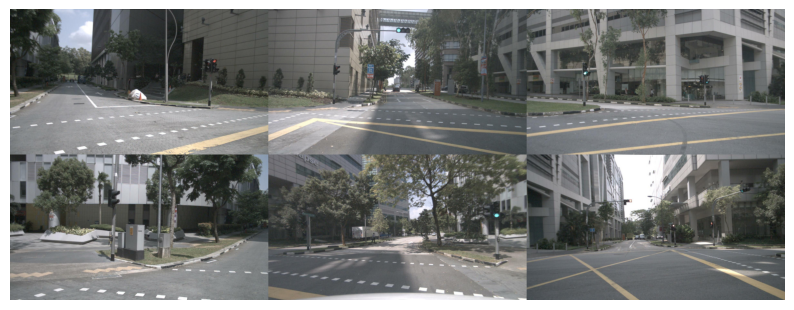

In [42]:
import os
import random
# tensor_list = sorted(os.listdir('/media/user/data4/nuscenes_data/features/CAM_FRONT_LEFT'))
tensor_list = (os.listdir('/media/user/data4/nuscenes_data/features/CAM_FRONT_LEFT'))
index = random.randint(0,len(tensor_list)-1)
index = 0
print(index)
pre_fix = tensor_list[index][:-10]
s = ['CAM_FRONT_LEFT','CAM_FRONT','CAM_FRONT_RIGHT','CAM_BACK_RIGHT','CAM_BACK','CAM_BACK_LEFT']
img_file = []
for i in range(6):
    cur_path = os.path.join('/media/user/data4/nuscenes_data/samples',s[i])
    l = sorted(os.listdir(cur_path))
    if i == 0:
        for j,img in enumerate(l):
            if img.startswith(pre_fix):
                break
    img_file.append(os.path.join(cur_path,l[j]))
read_img(img_file)

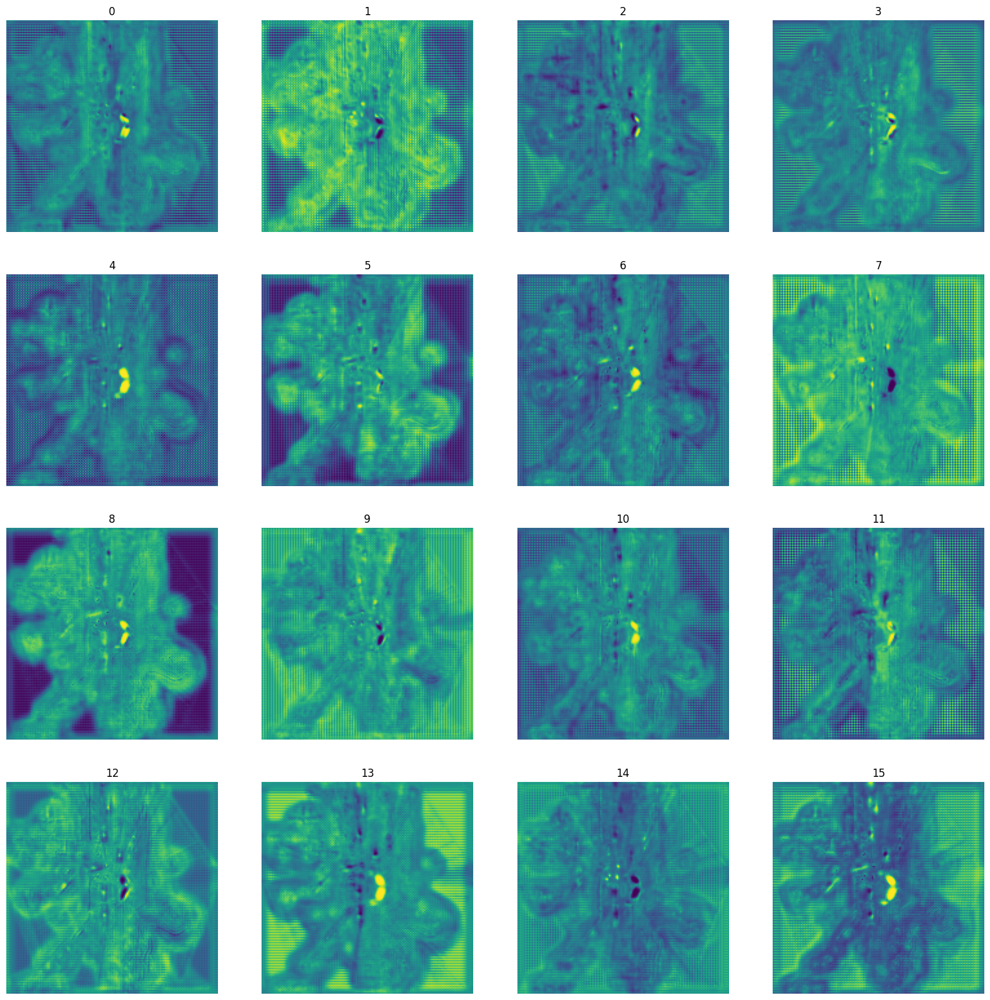

In [46]:
tensor = torch.load(os.path.join('/media/user/data4/nuscenes_data/features/CAM_FRONT_LEFT',tensor_list[index]))
draw_features(tensor,0)

In [43]:
cur_path = os.path.join('/media/user/data4/nuscenes_data/samples','LIDAR_TOP')
pts_file = sorted(os.listdir(cur_path))[j]
pts_file = os.path.join(cur_path,pts_file)
print(pts_file)

/media/user/data4/nuscenes_data/samples/LIDAR_TOP/n015-2018-07-24-11-22-45+0800__LIDAR_TOP__1532402753697708.pcd.bin


In [44]:
import struct
import numpy as np
from nuscenes.utils.data_classes import LidarPointCloud
import open3d as o3d
draw_pointcloud(pts_file)

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [6]:
import torch
import time
import cv2 

network.to(device)
network.eval()

images = list()
vis_list = list()
ins_list = list()
with torch.no_grad():
    for i,batch in enumerate(loader):
        vis_list.append(batch)
#         start = time.time()
        print(i,end='\r')
        for k, v in batch.items():
            if k!='features' or k!='center':
                if isinstance(v, torch.Tensor):
                    batch[k] = v.to(device)
                else:
                    batch[k] = v
        pred = network(batch,inspect=True)
#         pred = network(batch)
        ins_list.append(pred)

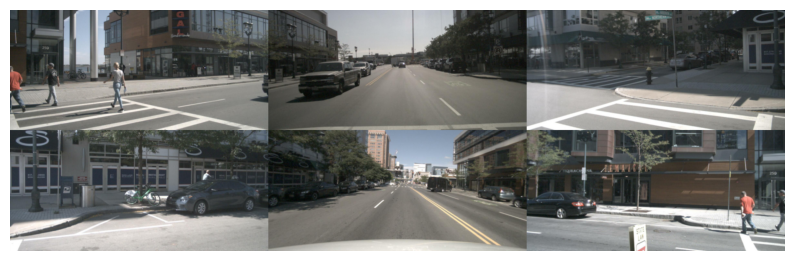

In [7]:
img_list = list()
index__ = 24
for img in vis_list[index__]['image'][0]:
    img_list.append(to_image(img))
read_img(img_list,read=False)

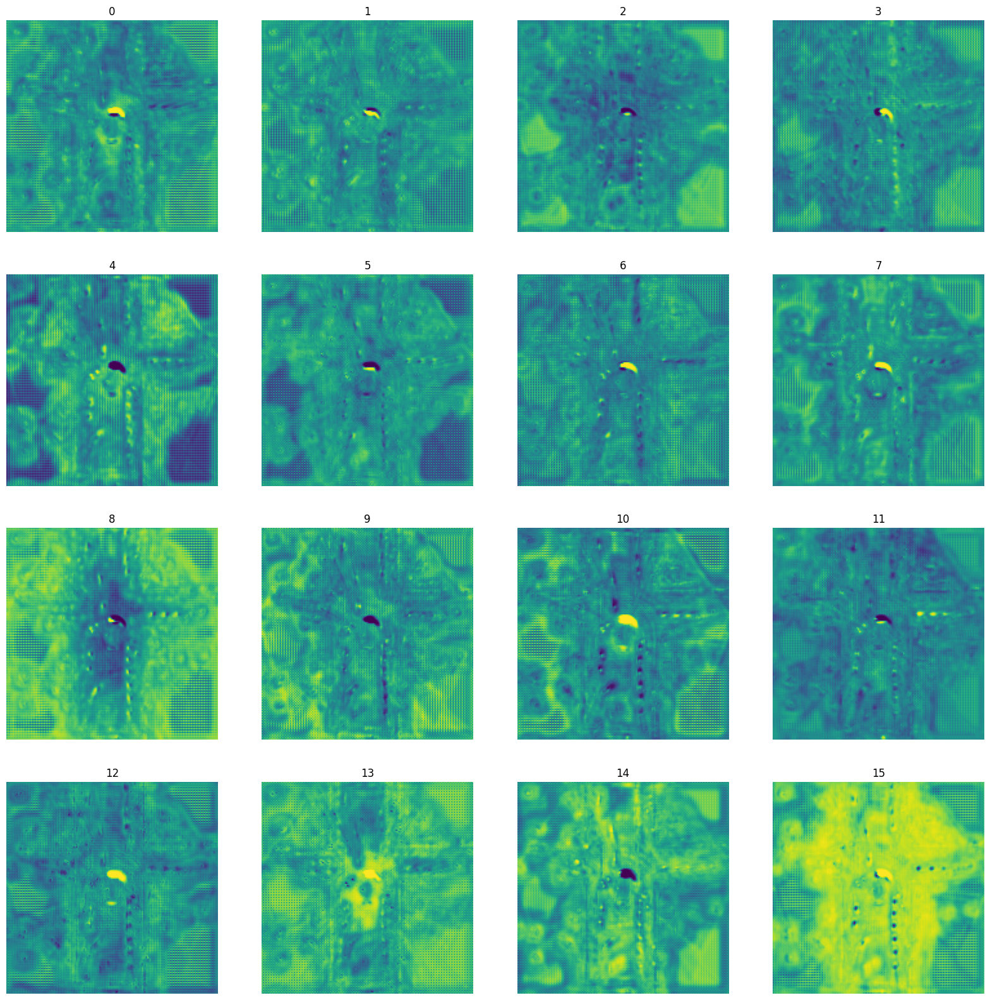

In [8]:
draw_features(vis_list[index__]['features'][0],0)

In [1]:
import os.path as osp
import struct
import numpy as np

from nuscenes.nuscenes import NuScenes
from nuscenes.utils.data_classes import LidarPointCloud,RadarPointCloud
from pyquaternion.quaternion import Quaternion
from nuscenes.utils.geometry_utils import transform_matrix
from nuscenes.utils import data_classes

import os 

import open3d as o3d
import matplotlib.pyplot as plt
from functools import reduce

# Load the nuScenes dataset (mini-split, in this case).
nusc = NuScenes(version='v1.0-trainval', dataroot='/media/user/data4/nuscenes_data', verbose=False)
radar_list = ['RADAR_FRONT','RADAR_FRONT_LEFT','RADAR_FRONT_RIGHT','RADAR_BACK_LEFT','RADAR_BACK_RIGHT']

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [101]:
scene_record = None
for i in nusc.scene:
    if i['name'] == 'scene-0519':
        scene_record = i
        break
scene_record

{'token': '26a6b03c8e2f4e6692f174a7074e54ff',
 'log_token': 'ca6d14b008ed4e0bb6b1eaaedadbd6c1',
 'nbr_samples': 41,
 'first_sample_token': '6123a0c091d24c39ab274cdbad994bc4',
 'last_sample_token': '30ebd85e1919479da0884b30f033fb6d',
 'name': 'scene-0520',
 'description': 'Pedestrian, parked vehicles'}

In [109]:
index = 17*5
record_index = None
for i,record in enumerate(nusc.scene):
    if record['name'] == 'scene-0519':
        record_index = i

while True:
    scene_record = nusc.scene[record_index]
    flag = False
    sample_token = scene_record['first_sample_token']
    i = 0
    while sample_token:
        sample_record = nusc.get('sample', sample_token)
        if i == index:
            flag = True
            break
        sample_token = sample_record['next']
        i += 1
    if flag:
        break
    else:
        index -= i
        record_index += 1

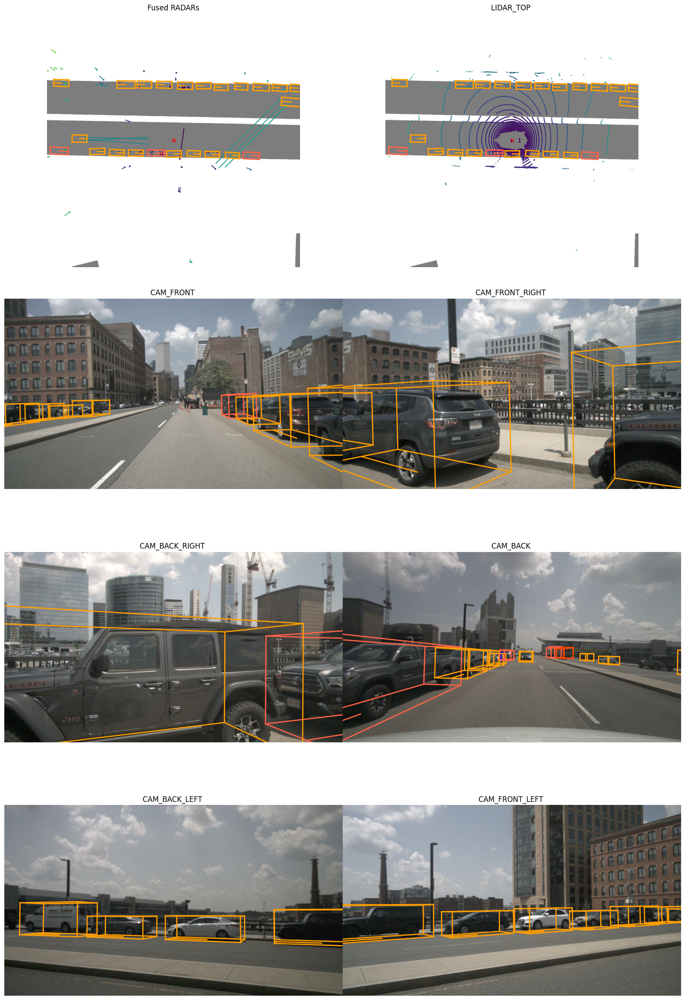

In [4]:
nusc.render_sample('a0e6403cfc0b48258d8fc78d34bf5b8c')

In [16]:
from pyquaternion import Quaternion
from nuscenes.utils.data_classes import Box
import cv2
XMIN, XMAX = -50, 50
ZMIN, ZMAX = -50, 50
YMIN, YMAX = -5, 5
Z, Y, X = 200, 8, 200
bounds = (XMIN, XMAX, YMIN, YMAX, ZMIN, ZMAX)
def gen_dx_bx(xbound, ybound, zbound):
    dx = np.array([row[2] for row in [xbound, ybound, zbound]])
    bx = np.array([row[0] + row[2]/2.0 for row in [xbound, ybound, zbound]])
    nx = np.array([int((row[1] - row[0]) / row[2]) for row in [xbound, ybound, zbound]])

    return dx, bx, nx

grid_conf = { # note the downstream util uses a different XYZ ordering
            'xbound': [XMIN, XMAX, (XMAX-XMIN)/float(X)],
            'ybound': [ZMIN, ZMAX, (ZMAX-ZMIN)/float(Z)],
            'zbound': [YMIN, YMAX, (YMAX-YMIN)/float(Y)],
        }
dx, bx, nx = gen_dx_bx(grid_conf['xbound'], grid_conf['ybound'], grid_conf['zbound'])

In [53]:
rec = sample_record
egopose = nusc.get('ego_pose', nusc.get('sample_data', rec['data']['LIDAR_TOP'])['ego_pose_token'])
trans = -np.array(egopose['translation'])
rot = Quaternion(egopose['rotation']).inverse
img = np.zeros((nx[0], nx[1]))

for ii, tok in enumerate(rec['anns']):
    inst = nusc.get('sample_annotation', tok)
    if inst['category_name'] not in ['vehicle.bus', 'vehicle.car', 'vehicle.construction_vehicle', 'vehicle.trailer', 'vehicle.truck']:
        continue

    box = Box(inst['translation'], inst['size'], Quaternion(inst['rotation']))
    box.translate(trans)
    box.rotate(rot)

    pts = box.bottom_corners()[:2].T
    pts = np.round(
        (pts - bx[:2] + dx[:2]/2.) / dx[:2]
        ).astype(np.int32)
    pts[:, [1, 0]] = pts[:, [0, 1]]
    cv2.fillPoly(img, [pts], 1.0)

In [80]:
img_2 = raw[0]['bev'][0][4].type(torch.IntTensor)
for i in [5,6,7,8]:
    img_2 = img_2 | raw[0]['bev'][0][i].type(torch.IntTensor)
img_3 = raw[0]['bev'][0][9].type(torch.IntTensor)

In [79]:
mask = raw[0]['visibility']>=3
img_2[mask[0]]

tensor([0, 0, 0,  ..., 0, 0, 0], dtype=torch.int32)

In [12]:
nusc.get('sample_data',sample_record['data']['CAM_FRONT'])

{'token': 'bf8c213cfaad4861907cd2677dc2dbcd',
 'sample_token': 'ed5fc18c31904f96a8f0dbb99ff069c0',
 'ego_pose_token': 'bf8c213cfaad4861907cd2677dc2dbcd',
 'calibrated_sensor_token': '1d31c729b073425e8e0202c5c6e66ee1',
 'timestamp': 1532402946762460,
 'fileformat': 'jpg',
 'is_key_frame': True,
 'height': 900,
 'width': 1600,
 'filename': 'samples/CAM_FRONT/n015-2018-07-24-11-22-45+0800__CAM_FRONT__1532402946762460.jpg',
 'prev': '4a149099adf444a79d8a48c04cff9dd7',
 'next': '',
 'sensor_modality': 'camera',
 'channel': 'CAM_FRONT'}

[[  3.4000001    1.29999995]
 [ 16.60000038   3.5       ]
 [ 15.80000019  -8.5       ]
 [ 18.60000038  -6.30000019]
 [ 16.79999924  15.30000019]
 [ 20.39999962 -14.30000019]
 [ 18.20000076  17.89999962]
 [ 24.20000076 -21.5       ]
 [ 26.79999924 -39.09999847]
 [ 47.59999847 -53.09999847]
 [ 54.79999924 -54.29999924]]


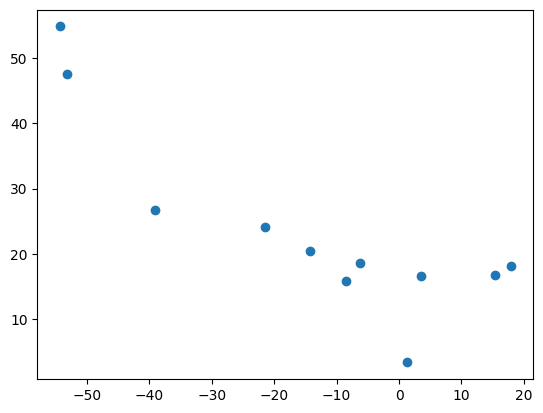

In [46]:
pointsensor_token = sample_record['data']['RADAR_FRONT_LEFT']
pointsensor = nusc.get('sample_data', pointsensor_token)
pcl_path = osp.join(nusc.dataroot, pointsensor['filename'])
pc = RadarPointCloud.from_file(pcl_path)
pc = pc.points.T
print(pc[:,:2])
plt.scatter(pc[:,1],pc[:,0])
plt.show()

In [4]:
out = None
for r in radar_list:
    pointsensor_token = sample_record['data'][r]
    pointsensor = nusc.get('sample_data', pointsensor_token)
    pose = nusc.get('calibrated_sensor', pointsensor['calibrated_sensor_token'])
    pcl_path = osp.join(nusc.dataroot, pointsensor['filename'])
    pc = RadarPointCloud.from_file(pcl_path)
    print(pc.shape)
    pc = pc.points.T
    pc.transform(transform_matrix(pose["translation"], Quaternion(pose["rotation"])))
    if out is not None:
        out = np.concatenate((out,pc),0)
    else:
        out = pc
# draw_pointcloud(pcl_path,False)

AttributeError: 'RadarPointCloud' object has no attribute 'shape'

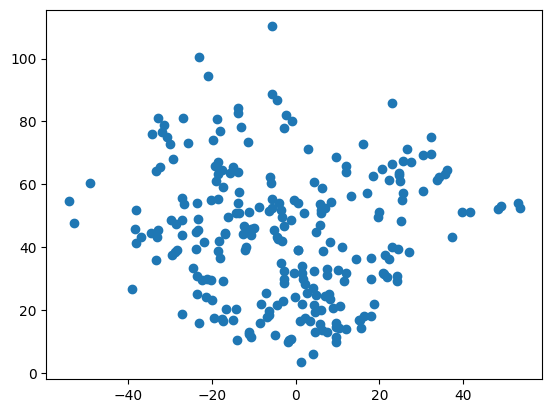

In [42]:
plt.scatter(out[:,1],out[:,0])
plt.show()

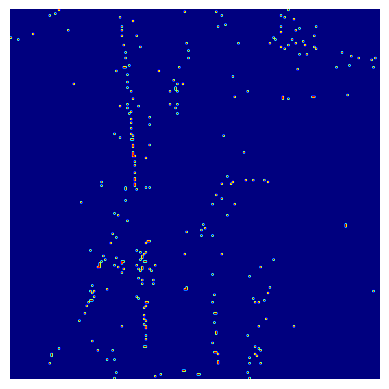

In [10]:
# sensor (calibrate)--> (ego) --> global (sensor_2 ego inverse) --> (sensor_2 calibrate inverse) --> sensor2 
use_radar_filters = False
min_distance = 2.2
sample_rec = sample_record
h,w = 200,200
V = get_view_matrix(h=h,w=w,flip=True)
S = np.array([
            [1, 0, 0, 0],
            [0, 1, 0, 0],
            [0, 0, 0, 1],
        ])

points = np.zeros((19, 0)) # 18 plus one for time
# Get reference pose and timestamp.
ref_sd_token = sample_rec['data']['LIDAR_TOP']
ref_sd_rec = nusc.get('sample_data', ref_sd_token)
ref_pose_rec = nusc.get('ego_pose', ref_sd_rec['ego_pose_token'])
ref_cs_rec = nusc.get('calibrated_sensor', ref_sd_rec['calibrated_sensor_token'])

# Homogeneous transformation matrix from global to _current_ ego car frame.
# calibrated
sensor_from_car = transform_matrix(ref_cs_rec['translation'], Quaternion(ref_cs_rec['rotation']),inverse=True)
# ego pose
car_from_global = transform_matrix(ref_pose_rec['translation'], Quaternion(ref_pose_rec['rotation']),inverse=True)

sensor_from_car = parse_pose(ref_cs_rec,inv=True)
car_from_global = parse_pose(ref_pose_rec,inv=True)
if use_radar_filters:
    RadarPointCloud.default_filters()
else:
    RadarPointCloud.disable_filters()

# Aggregate current and previous sweeps.
# from all radars 
out_l_2 = []
radar_chan_list = ["RADAR_BACK_RIGHT", "RADAR_BACK_LEFT", "RADAR_FRONT", "RADAR_FRONT_LEFT", "RADAR_FRONT_RIGHT"]
for radar_name in radar_chan_list:
    sample_data_token = sample_rec['data'][radar_name]
    current_sd_rec = nusc.get('sample_data', sample_data_token)
    # Load up the pointcloud and remove points close to the sensor.
    current_pc = RadarPointCloud.from_file(os.path.join(nusc.dataroot, current_sd_rec['filename']))
    current_pc.remove_close(min_distance)
    
    # Get past pose.
    current_pose_rec = nusc.get('ego_pose', current_sd_rec['ego_pose_token'])
#     global_from_car = transform_matrix(current_pose_rec['translation'],
#                                         Quaternion(current_pose_rec['rotation']), inverse=False)
    global_from_car = parse_pose(current_pose_rec)
    # Homogeneous transformation matrix from sensor coordinate frame to ego car frame.
    current_cs_rec = nusc.get('calibrated_sensor', current_sd_rec['calibrated_sensor_token'])
#     car_from_current = transform_matrix(current_cs_rec['translation'], Quaternion(current_cs_rec['rotation']),
#                                         inverse=False)
    car_from_current = parse_pose(current_cs_rec)

    # Fuse four transformation matrices into one and perform transform. lidar_sensor, lidar ego, radar ego, radar sensor
    trans_matrix = reduce(np.dot, [sensor_from_car,car_from_global, global_from_car, car_from_current]) # [sensor_from_car,car_from_global, global_from_car, car_from_current]
    current_pc.transform(trans_matrix)
    out_l_2.append(current_pc.points)

out_lidar = np.concatenate(out_l_2,1)
out_bev = np.array(out_lidar)

out_bev[:3] = V @ S @ np.vstack((out_lidar[:3],np.ones(out_lidar.shape[1])))

mask = mask_out(out_bev)
out_bev = out_bev[:,mask]
# out_l = out_l.astype(int)
instances = np.array([i+1 for i in range(out_bev.shape[1])])
# radar_map = np.zeros((200,200,15),dtype=float)
# radar_map[out_l[1,:],out_l[0,:]] = np.transpose(out_l[3:,:])
radar_map = np.zeros((h,w),dtype=float)
radar_map[out_bev[1,:].astype(int),out_bev[0,:].astype(int)] = 1

# print(out_l[3:,0])
# radar_map[out_l[1,0],out_l[0,0]]
# plt.figure(figsize=(10,10))
plt.imshow(radar_map,cmap='jet')
plt.axis('off')
plt.show()
# cv2.imshow('My Image', radar_map)

# # # 按下任意鍵則關閉所有視窗
# cv2.waitKey(0)
# cv2.destroyAllWindows()

In [13]:
k = {}
count = 0
for i in range(out_bev.shape[1]):
    t = (out_bev[0,i],out_bev[1,i])
    if t not in k:
        k[t] = 1
    else:
        count += 1
count

1

In [85]:
tmp = np.zeros((3,5),dtype=float)
tmp2 = np.ones((1,5),dtype=float)
np.vstack((tmp,tmp2))[:,0]


array([0., 0., 0., 1.])

In [45]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
coor = out_l[:2,:].T
# vxvy = out_l[6:8,:]
# dx = np.concatenate((coor,vxvy)).T
dx = out_l[3:].T
n_clusters = 2
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(dx)
# 預測新的目標值 label
new_dy = kmeans.predict(dx)
plt.rcParams['font.size'] = 14
# plt.figure(figsize=(16, 8))
# 以不同顏色畫出原始的 10 群資料
# plt.subplot(121)
# plt.title('Original data (10 groups)')
# plt.scatter(dx.T[0], dx.T[1], c=dy, cmap=plt.cm.Set1)
# 根據重新分成的 5 組來畫出資料
plt.imshow(mask,cmap='jet',alpha=0.3)
plt.scatter(coor.T[0], coor.T[1], c=new_dy/n_clusters, cmap=plt.cm.Set1,s=1)
# plt.imshow(mask_drivable,alpha=0.1,cmap='jet')
# 顯示圖表
plt.axis([0, 200, 200, 0])
plt.show()

/home/user/miniconda3/envs/cvt/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


NameError: name 'mask' is not defined

In [181]:
from nuscenes.map_expansion.map_api import NuScenesMap

nusc_map = NuScenesMap(dataroot='/media/user/data4/nuscenes_data/', map_name='boston-seaport')

layers = ['road_divider', 'lane_divider']
V = get_view_matrix(flip=False)
M_inv = car_from_global
lidar2global = (V @ S @ M_inv)
rotation = lidar2global[:3, :3]
v = np.dot(rotation, np.array([1, 0, 0]))
yaw = np.arctan2(v[1], v[0])
angle = (yaw / np.pi * 180)

global_from_car = transform_matrix(ref_pose_rec['translation'], Quaternion(ref_pose_rec['rotation']),inverse=False)
map_mask = nusc_map.get_map_mask((global_from_car[0][-1],global_from_car[1][-1],100,100), angle, layers, (200,200))
result = [np.flipud(i) for i in map_mask]

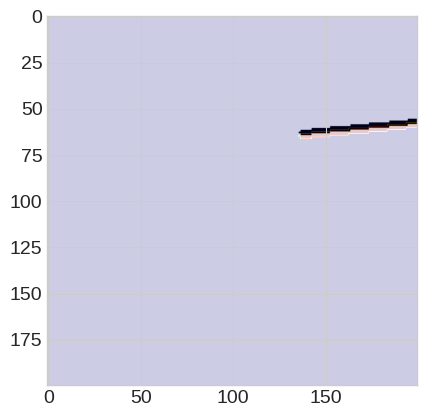

In [192]:
plt.imshow(result[0])
plt.imshow(raw[0]['bev'][0,2],cmap='jet',alpha=0.2)

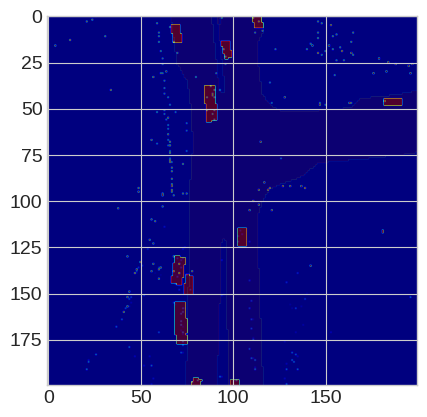

In [196]:
# plt.imshow(radar_map)
indexs = [5, 6, 7, 8, 10, 11]
mask = raw[0]['bev'][0,4]
for i in indexs:
    mask = mask.type(torch.bool) | raw[0]['bev'][0,i].type(torch.bool)
mask_drivable = raw[0]['bev'][0,0].type(torch.bool) | raw[0]['bev'][0,1].type(torch.bool)
mask = mask.type(torch.float32)
plt.imshow(mask,cmap='jet')
plt.imshow(radar_map,alpha=0.4,cmap='jet')
plt.imshow(mask_drivable,alpha=0.1,cmap='jet')
plt.show()

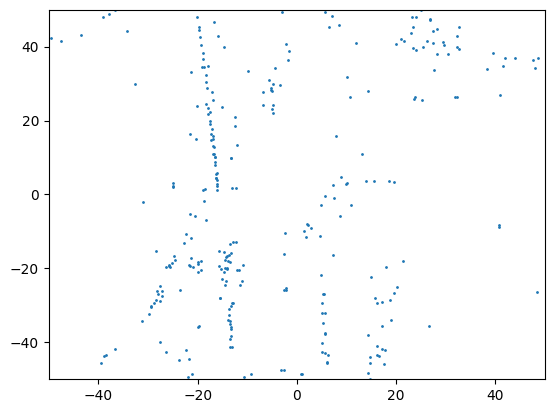

In [202]:
plt.scatter(out_l_tmp[0,:],out_l_tmp[1,:],s=1)
plt.xlim(-50,50)
plt.ylim(-50,50)
plt.show()

In [298]:
cam_record = nusc.get('sample_data',sample_rec['data']['CAM_FRONT'])
egocam = nusc.get('ego_pose', cam_record['ego_pose_token'])
cam = nusc.get('calibrated_sensor', cam_record['calibrated_sensor_token'])

cam_from_egocam = parse_pose(cam, inv=True)
egocam_from_world = parse_pose(egocam, inv=True)
intrinsics = cam['camera_intrinsic']
intrinsics = np.array(intrinsics)
print(np.round(intrinsics))

[[1.253e+03 0.000e+00 8.270e+02]
 [0.000e+00 1.253e+03 4.700e+02]
 [0.000e+00 0.000e+00 1.000e+00]]


torch.Size([1, 14, 25, 25])


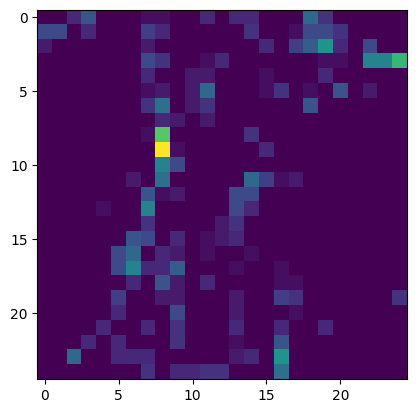

In [343]:
r_tmp = torch.nn.functional.adaptive_avg_pool2d(raw[0]['radar'],(25,25))
print(r_tmp.shape)
plt.imshow(r_tmp[0,0])

In [4]:
intrinsics = raw[0]['intrinsics'][0,1].cpu().numpy()
intrinsics_inv = raw[0]['intrinsics'][0,1].inverse() .cpu().numpy()
extrinsics = raw[0]['extrinsics'][0,1].cpu().numpy()
extrinsics_inv = raw[0]['extrinsics'][0,1].inverse() .cpu().numpy()
pos_inverse = raw[0]['pose'][0].inverse().cpu().numpy()
tmp = np.concatenate(out_l_2,1)
new = extrinsics @ np.vstack((tmp[:3],np.ones(tmp.shape[1])))

NameError: name 'out_l_2' is not defined

In [5]:
print(raw[0]['extrinsics'][0,1].cpu().numpy())
extrinsics

[[ 0.01108553 -0.9998911  -0.00974361  0.00866699]
 [ 0.03193313  0.01009324 -0.99943906  1.4836788 ]
 [ 0.9994285   0.01076815  0.03204154 -1.6239471 ]
 [ 0.          0.          0.          1.        ]]


array([[ 0.01108553, -0.9998911 , -0.00974361,  0.00866699],
       [ 0.03193313,  0.01009324, -0.99943906,  1.4836788 ],
       [ 0.9994285 ,  0.01076815,  0.03204154, -1.6239471 ],
       [ 0.        ,  0.        ,  0.        ,  1.        ]],
      dtype=float32)

In [9]:
pts_tmp = np.array([[20,20],[100,30],[500,250],[540,860]]).T
pts_tmp = intrinsics_inv @ np.vstack((pts_tmp,np.ones(pts_tmp.shape[1])))
pts_tmp = extrinsics_inv @ np.vstack((pts_tmp,np.ones(pts_tmp.shape[1])))
print(pts_tmp[:3])
V = get_view_matrix(h=200,w=200,flip=False)
S = np.array([
            [1, 0, 0, 0],
            [0, 1, 0, 0],
            [0, 0, 0, 1],
        ])
V @ S @ pts_tmp 

[[ 2.56187711  2.56508635  2.59557638  2.6485841 ]
 [ 0.62643809  0.4138755  -0.6443721  -0.73440619]
 [ 1.77234314  1.7436773   1.14828651 -0.47485402]]


array([[ 98.74712382,  99.17224899, 101.2887442 , 101.46881238],
       [ 94.87624578,  94.8698273 ,  94.80884725,  94.70283181],
       [  1.        ,   1.        ,   1.        ,   1.        ]])

In [49]:
def view_points(points: np.ndarray, view: np.ndarray, normalize: bool) -> np.ndarray:
    """
    This is a helper class that maps 3d points to a 2d plane. It can be used to implement both perspective and
    orthographic projections. It first applies the dot product between the points and the view. By convention,
    the view should be such that the data is projected onto the first 2 axis. It then optionally applies a
    normalization along the third dimension.

    For a perspective projection the view should be a 3x3 camera matrix, and normalize=True
    For an orthographic projection with translation the view is a 3x4 matrix and normalize=False
    For an orthographic projection without translation the view is a 3x3 matrix (optionally 3x4 with last columns
     all zeros) and normalize=False

    :param points: <np.float32: 3, n> Matrix of points, where each point (x, y, z) is along each column.
    :param view: <np.float32: n, n>. Defines an arbitrary projection (n <= 4).
        The projection should be such that the corners are projected onto the first 2 axis.
    :param normalize: Whether to normalize the remaining coordinate (along the third axis).
    :return: <np.float32: 3, n>. Mapped point. If normalize=False, the third coordinate is the height.
    """

    assert view.shape[0] <= 4
    assert view.shape[1] <= 4
    assert points.shape[0] == 3
    
    viewpad = np.eye(4)
    viewpad[:view.shape[0], :view.shape[1]] = view
    print(viewpad)
    nbr_points = points.shape[1]

    # Do operation in homogenous coordinates.
    points = np.concatenate((points, np.ones((1, nbr_points))))
    points = np.dot(viewpad, points)
    points = points[:3, :]
    if normalize:
        points = points / points[2:3, :].repeat(3, 0)#.reshape(3, nbr_points)
    return points


In [10]:
# from nuscenes.utils.geometry_utils import view_points
from PIL import Image
# intrinsics @ extrinsics @ np.vstack((out_l_2[1][:3],np.ones(out_l_2[2].shape[1])))
out_l_2_tmp = extrinsics @np.vstack((out_l_2[2][:3],np.ones(out_l_2[2].shape[1])))
depths = out_l_2_tmp[2, :]
points_tmp = view_points(out_l_2_tmp[:3, :], intrinsics, normalize=True)
# out_l_2_tmp = intrinsics @ out_l_2_tmp[:3]
points_tmp,depths = mask_out(points_tmp,radar=False,depths=depths,filter_depths=50)
depths = depths/np.max(depths) * 255
# out_l_2_tmp.shape
file_path = nusc.get('sample_data',sample_rec['data']['CAM_FRONT'])['filename']
# img = Image.open(nusc.dataroot+'/'+nusc.get('sample_data',sample_rec['data']['CAM_FRONT'])['filename'])
# img = img.resize((480,224))
img = to_image(raw[0]['image'][0,1])
# img = cv2.imread(nusc.dataroot+'/'+nusc.get('sample_data',sample_rec['data']['CAM_FRONT'])['filename'])
# for pp in points_tmp.T:
#     pp = np.round(pp).astype(int)
#     img[pp[0],pp[1]] = [255,255,255]
plt.imshow(img)
plt.scatter(points_tmp[0, :], points_tmp[1, :],c=depths,s=5)
plt.axis('off')
plt.show

NameError: name 'out_l_2' is not defined

In [7]:
def get_transformation_matrix(R, t, inv=False):
    pose = np.eye(4, dtype=np.float32)
    pose[:3, :3] = R if not inv else R.T
    pose[:3, -1] = t if not inv else R.T @ -t

    return pose


def get_pose(rotation, translation, inv=False, flat=False):
    if flat:
        yaw = Quaternion(rotation).yaw_pitch_roll[0]
        R = Quaternion(scalar=np.cos(yaw / 2), vector=[0, 0, np.sin(yaw / 2)]).rotation_matrix
    else:
        R = Quaternion(rotation).rotation_matrix

    t = np.array(translation, dtype=np.float32)

    return get_transformation_matrix(R, t, inv=inv)
def parse_pose(record, *args, **kwargs):
    return get_pose(record['rotation'], record['translation'], *args, **kwargs)

def get_view_matrix(h=200, w=200, h_meters=100.0, w_meters=100.0, offset=0.0,flip=False):
    sh = h / h_meters
    sw = w / w_meters
    if not flip:
        return np.float32([
            [ 0., -sw,          w/2.],
            [-sh,  0., h*offset+h/2.],
            [ 0.,  0.,            1.]
        ])
    else:
        return np.float32([
            [ sw, 0,          w/2.],
            [0,  -sh, h*offset+h/2.],
            [ 0.,  0.,            1.]
        ])

def mask_out(out_l,y=[0,200],x=[0,200],radar=True,depths=None,filter_depths=None):
    if radar:
        mask = np.ones(out_l.shape[1], dtype=bool)
        mask = np.logical_and(mask, out_l[0, :] < y[1])
        mask = np.logical_and(mask, out_l[0, :] >= y[0])
        mask = np.logical_and(mask, out_l[1, :] >= x[0])
        mask = np.logical_and(mask, out_l[1, :] < x[1])
        return mask
    else:
        mask = np.ones(out_l.shape[1], dtype=bool)
        mask = np.logical_and(mask, out_l[0, :] < 480-1)
        mask = np.logical_and(mask, out_l[0, :] > 1 )
        mask = np.logical_and(mask, out_l[1, :] > 1)
        mask = np.logical_and(mask, out_l[1, :] < 224-1)
        if filter_depths is not None:
            mask = np.logical_and(mask, depths < filter_depths)
        depths = depths[None]
        return out_l[:,mask],depths[:,mask]
    
def generate_grid(height: int, width: int):
    xs = torch.linspace(0, 1, width)
    ys = torch.linspace(0, 1, height)

    indices = torch.stack(torch.meshgrid((xs, ys), indexing='xy'), 0)       # 2 h w
    indices = F.pad(indices, (0, 0, 0, 0, 0, 1), value=1)                   # 3 h w
    indices = indices[None]                                                 # 1 3 h w

    return indices

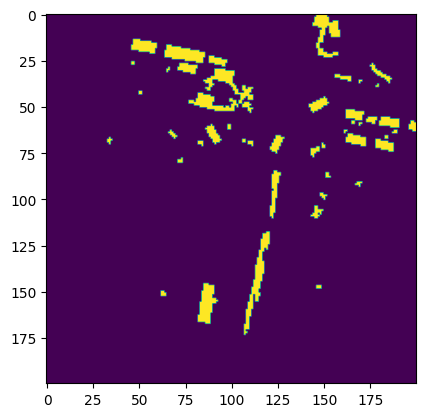

In [47]:
import cv2
def get_p(box,V,S,M_inv,i_inv=None):
    corners = box.bottom_corners()                                              # 3 4
    center = corners.mean(-1)                                                   # 3
    front = (corners[:, 0] + corners[:, 1]) / 2.0                               # 3
    left = (corners[:, 0] + corners[:, 3]) / 2.0                                # 3

    p = np.concatenate((corners, np.stack((center, front, left), -1)), -1)      # 3 7
    p = np.pad(p, ((0, 1), (0, 0)), constant_values=1.0)                        # 4 7
    if i_inv is None:
        p = V @ S @ M_inv @ p                                                       # 3 7
    else:
        p = V @ S @ i_inv @ M_inv @ p
    p = p[:2, :4]
#     print(p)
    return p 

index = 23
h, w = 200,200
render = np.zeros((h, w), dtype=np.uint8)
a = nusc.get('sample_annotation', sample_rec['anns'][index])
V = get_view_matrix(flip=True)
S = np.array([
            [1, 0, 0, 0],
            [0, 1, 0, 0],
            [0, 0, 0, 1],
        ])
scale_matrix = np.eye(4)

# Define the translation matrix
translation_matrix = np.array([
              [2, 0, 100],  # Translation in x-axis by 100 units
              [0, -2, 100],  # Translation in y-axis by 100 units and flip
              [0, 0, 1]])    # Homogeneous coordinate
M_inv = transform_matrix(ref_pose_rec['translation'], Quaternion(ref_pose_rec['rotation']),inverse=True)
C_inv = transform_matrix(ref_cs_rec['translation'], Quaternion(ref_cs_rec['rotation']),inverse=True)
M_inv2 = parse_pose(ref_pose_rec,flat=True,inv=True)
C_inv2 = parse_pose(ref_cs_rec,flat=True,inv=True)
for token in sample_rec['anns']:
    a = nusc.get('sample_annotation', token)
    box = data_classes.Box(a['translation'], a['size'], Quaternion(a['rotation']))
    p = get_p(box,V,S,C_inv2@M_inv2)
    cv2.fillPoly(render, [p.round().astype(np.int32).T], 1, cv2.LINE_8)
    



a = nusc.get('sample_annotation', sample_rec['anns'][index])
box = data_classes.Box(a['translation'], a['size'], Quaternion(a['rotation']))
p_origin = get_p(box,V,S, car_from_global)
# print(p.shape)
p = get_p(box,translation_matrix,S, car_from_global,sensor_from_car)
plt.imshow(render)

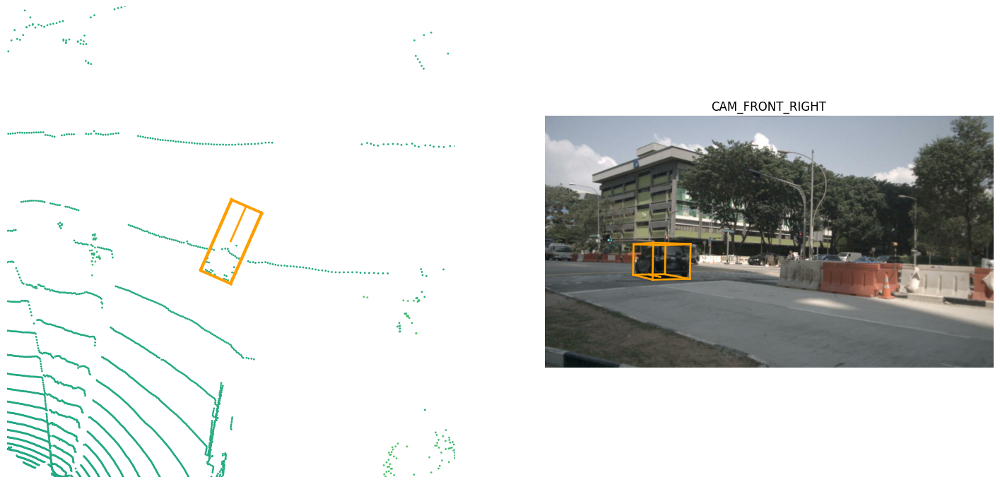

In [99]:
nusc.render_annotation(sample_rec['anns'][index])

In [21]:
import time
out_l[1,:] = out_l[1,:]*(-1)
out_l = np.round(out_l).astype(int)
radar_map = np.zeros((200,200,15),dtype=float)
s = time.time()
radar_map[out_l[1,:]+100,out_l[0,:]+100] = np.transpose(out_l[3:,:])
print(time.time()-s)
# s = time.time()
# out_l = np.transpose(out_l)
# for p in out_l:
#     radar_map[p[1]+100,p[0]+100] = 1
# print(time.time()-s)
# plt.scatter(out_l[0,:],out_l[1,:])
# plt.imshow(radar_map,cmap='gray')
# plt.show()
# print(out_l[:,0])
# radar_map[out_l[1,0]+100,out_l[0,0]+100]
np.savez_compressed('/media/user/data4/TommyLu/cross_view_transformers/test.npz',radar=radar_map)

0.0008344650268554688


In [13]:
import time
out_l[1,:] = out_l[1,:]*(-1)
out_l = np.round(out_l).astype(int)
radar_map = np.zeros((200,200),dtype=float)
s = time.time()
radar_map[out_l[1,:]+100,out_l[0,:]+100] = 1
print(time.time()-s)
# s = time.time()
# out_l = np.transpose(out_l)
# for p in out_l:
#     radar_map[p[1]+100,p[0]+100] = 1
# print(time.time()-s)
plt.imshow(radar_map,cmap='gray')
plt.show()
# print(out_l[:,0])

IndexError: index 216 is out of bounds for axis 1 with size 200

0.00017905235290527344


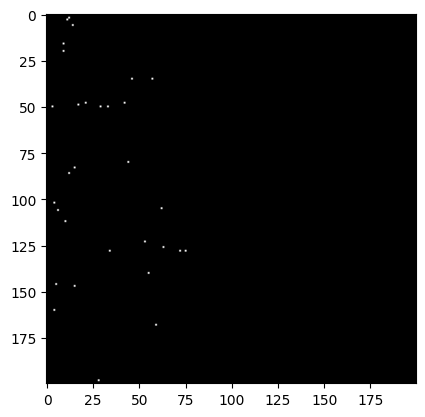

In [15]:
import time
out_l = mask_out(out_l)
out_l = np.round(out_l).astype(int)
# out_l = np.transpose(out_l)
radar_map = np.zeros((200,200),dtype=float)
s = time.time()
radar_map[out_l[0,:],out_l[1,:]] = 1
print(time.time()-s)
# s = time.time()
# out_l = np.transpose(out_l)
# for p in out_l:
#     radar_map[p[1]+100,p[0]+100] = 1
# print(time.time()-s)
plt.imshow(radar_map,cmap='gray')
plt.show()
# print(out_l[:,0])

In [109]:
from nuscenes.utils.geometry_utils import view_points
points = view_points(out_l[0][:3, :], np.array(ref_cs_rec['camera_intrinsic']), normalize=True)
points[:,:3]

array([[-339.24953755, -156.65615426, -599.58853685],
       [ 302.94345219,  327.39131152,  308.82464622],
       [   1.        ,    1.        ,    1.        ]])

In [123]:
# 5.906728  , -5.69977942
out_l[0][:2,0]

array([-4.78312811, -5.89975364])

RADAR_BACK_RIGHT
RADAR_BACK_LEFT
RADAR_FRONT
RADAR_FRONT_LEFT
RADAR_FRONT_RIGHT


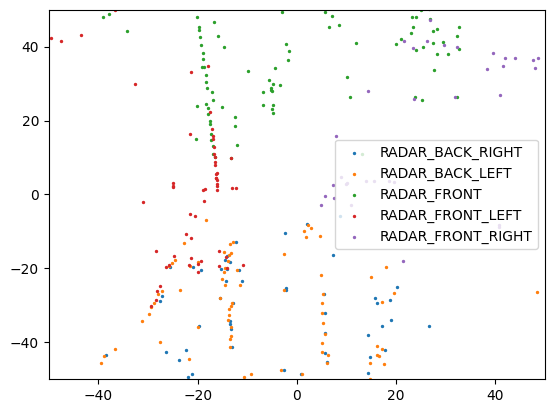

In [207]:
for points,s in zip(out_l_2,radar_chan_list):
#     points = mask_out(points)
    print(s)
    plt.scatter(points[0,:],points[1,:],s=2,label=s)
plt.legend()
plt.xlim(-50,50)
plt.ylim(-50,50)
plt.show()

In [56]:
for points,s in zip(out_l,radar_chan_list):
    print(points[:2,0])
    plt.scatter(out_l[1,:],out_l[0,:],label=s)
plt.legend()
plt.show()

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

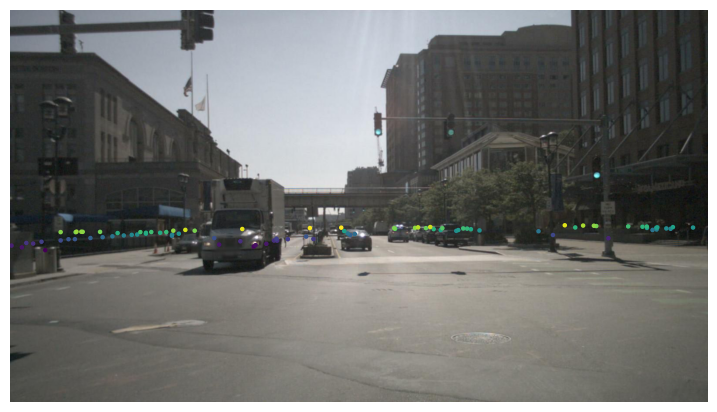

In [248]:
nusc.render_pointcloud_in_image(sample_rec['token'], pointsensor_channel='RADAR_FRONT',camera_channel='CAM_FRONT')

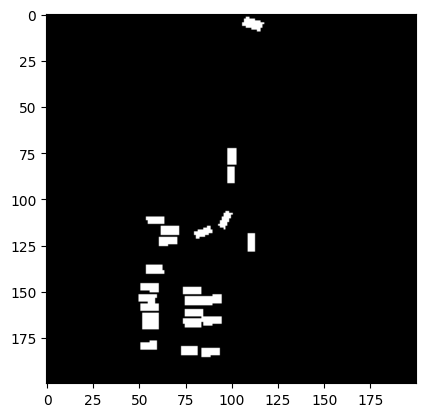

In [9]:
import numpy as np
from PIL import Image
path = "/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v5/scene-0003/bev_fd8420396768425eabec9bdddf7e64b6.png"
path_radar = "/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v5/scene-0003/radar_fd8420396768425eabec9bdddf7e64b6.npz"
def decode(img, n):
    """
    returns (h, w, n) np.int32 {0, 1}
    """
    shift = np.arange(n, dtype=np.int32)[None, None]

    x = np.array(img)[..., None]
    x = (x >> shift) & 1

    return x
bev = Image.open(path)
bev = decode(bev, 12)
bev = (255 * bev).astype(np.uint8)
plt.imshow(bev[:,:,4],cmap='gray')

In [19]:
radar = np.load(path_radar)['radar']
print(radar[:,:,7].sum())
radar2 = np.concatenate((radar[:,:,:7],radar[:,:,8:]),-1)
print(radar2.shape)

143.0
(200, 200, 14)


In [3]:
from PIL import Image
path = "/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v3/scene-0003/bev_fd8420396768425eabec9bdddf7e64b6.png"
def decode(img, n):
    """
    returns (h, w, n) np.int32 {0, 1}
    """
    shift = np.arange(n, dtype=np.int32)[None, None]

    x = np.array(img)[..., None]
    x = (x >> shift) & 1

    return x
bev = Image.open(path)
bev = decode(bev, 12)
bev = (255 * bev).astype(np.uint8)
plt.imshow(bev[:,:,4],cmap='gray')

NameError: name 'plt' is not defined

In [69]:
index = None
for i in range(len(nusc.scene)):
    if nusc.scene[i]['name'] == 'scene-0003':
        index = i
        break

In [108]:
scene_record = nusc.scene[index]
sample_token = scene_record['first_sample_token']
sample_rec = nusc.get('sample', sample_token)

(200, 200, 15)


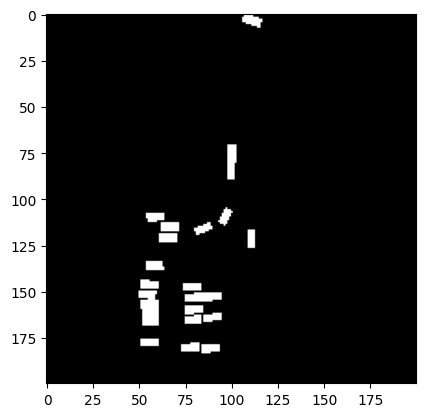

In [63]:
radar = np.load(path_radar)['radar']
print(radar.shape)
render = np.zeros((200,200,3)).astype(int)
for i,x in enumerate(radar):
    for j,y in enumerate(x):
        if not (y == np.zeros(15)).all():
            render[i,j] = [100,200,150]
plt.imshow(render)
plt.imshow(bev[:,:,4],cmap='gray')       

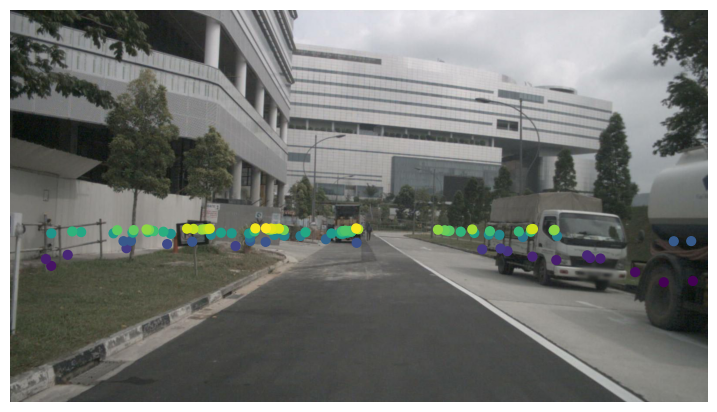

In [215]:
nusc.render_pointcloud_in_image(nusc.sample[6]['token'], pointsensor_channel='RADAR_FRONT',camera_channel='CAM_FRONT',dot_size=40)

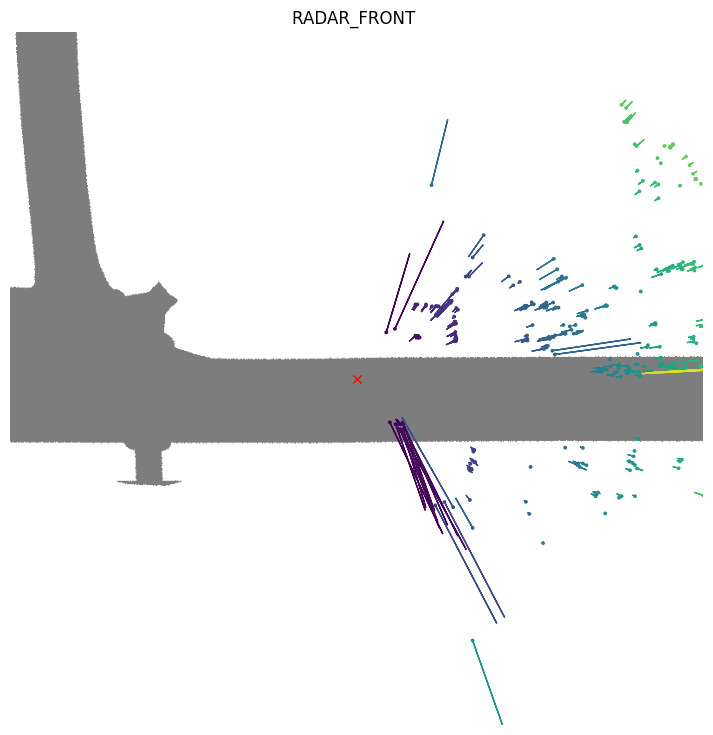

In [19]:
nusc.render_sample_data(sample_rec['data']['RADAR_FRONT'], nsweeps=5, underlay_map=True,with_anns=False)

In [144]:
x = 4.0
y = 1.73
points = np.array([
                [-4.0 / 2 + 0.3, -1.73 / 2, 1],
                [-4.0 / 2 + 0.3,  1.73 / 2, 1],
                [ 4.0 / 2 + 0.3,  1.73 / 2, 1],
                [ 4.0 / 2 + 0.3, -1.73 / 2, 1],
            ])
print(points)
tmp = np.array(points[:,0])
points[:,0] = points[:,1]
points[:,1] = tmp
print(points)

[[-1.7   -0.865  1.   ]
 [-1.7    0.865  1.   ]
 [ 2.3    0.865  1.   ]
 [ 2.3   -0.865  1.   ]]
[[-0.865 -1.7    1.   ]
 [ 0.865 -1.7    1.   ]
 [ 0.865  2.3    1.   ]
 [-0.865  2.3    1.   ]]


In [54]:
# sensor (calibrate)--> (ego) --> global (sensor_2 ego inverse) --> (sensor_2 calibrate inverse) --> sensor2 
def get_radar_points(sample_rec):
    use_radar_filters = False
    min_distance = 0.5


    points = np.zeros((19, 0)) # 18 plus one for time
    # Get reference pose and timestamp.
    ref_sd_token = sample_rec['data']['LIDAR_TOP']
    ref_sd_rec = nusc.get('sample_data', ref_sd_token)
    ref_pose_rec = nusc.get('ego_pose', ref_sd_rec['ego_pose_token'])
    ref_cs_rec = nusc.get('calibrated_sensor', ref_sd_rec['calibrated_sensor_token'])
    ref_time = 1e-6 * ref_sd_rec['timestamp']

    # Homogeneous transformation matrix from global to _current_ ego car frame.
    # calibrated
    sensor_from_car = transform_matrix(ref_cs_rec['translation'], Quaternion(ref_cs_rec['rotation']),inverse=True)
    # ego pose
    car_from_global = transform_matrix(ref_pose_rec['translation'], Quaternion(ref_pose_rec['rotation']),inverse=True)

    if use_radar_filters:
        RadarPointCloud.default_filters()
    else:
        RadarPointCloud.disable_filters()

    # Aggregate current and previous sweeps.
    # from all radars 
    out_l_2 = []
    radar_chan_list = ["RADAR_BACK_RIGHT", "RADAR_BACK_LEFT", "RADAR_FRONT", "RADAR_FRONT_LEFT", "RADAR_FRONT_RIGHT"]
    for radar_name in radar_chan_list:
        sample_data_token = sample_rec['data'][radar_name]
        current_sd_rec = nusc.get('sample_data', sample_data_token)
        # Load up the pointcloud and remove points close to the sensor.
        current_pc = RadarPointCloud.from_file(os.path.join(nusc.dataroot, current_sd_rec['filename']))
        current_pc.remove_close(min_distance)

        # Get past pose.
        current_pose_rec = nusc.get('ego_pose', current_sd_rec['ego_pose_token'])
        global_from_car = transform_matrix(current_pose_rec['translation'],
                                            Quaternion(current_pose_rec['rotation']), inverse=False)
        global_from_car = parse_pose(current_pose_rec)
        # Homogeneous transformation matrix from sensor coordinate frame to ego car frame.
        current_cs_rec = nusc.get('calibrated_sensor', current_sd_rec['calibrated_sensor_token'])
        car_from_current = transform_matrix(current_cs_rec['translation'], Quaternion(current_cs_rec['rotation']),
                                            inverse=False)
        car_from_current = parse_pose(current_cs_rec)

        # Fuse four transformation matrices into one and perform transform. lidar_sensor, lidar ego, radar ego, radar sensor
        trans_matrix = reduce(np.dot, [sensor_from_car,car_from_global, global_from_car, car_from_current]) 
        current_pc.transform(trans_matrix)
        out_l_2.append(current_pc.points)

    out_l = np.concatenate(out_l_2,1)
    V = get_view_matrix(flip=True)
    S = np.array([
                [1, 0, 0, 0],
                [0, 1, 0, 0],
                [0, 0, 0, 1],
            ])
    out_l[:3] = V @ S @ np.vstack((out_l[:3],np.ones(out_l.shape[1])))

    out_l = mask_out(out_l,False)
    return out_l

In [3]:
from PIL import Image
def decode(img, n):
    """
    returns (h, w, n) np.int32 {0, 1}
    """
    shift = np.arange(n, dtype=np.int32)[None, None]

    x = np.array(img)[..., None]
    x = (x >> shift) & 1

    return x

def read_bev(path,num_classes):
    bev = Image.open(path)
    bev = decode(bev, num_classes)
    bev = (255 * bev).astype(np.uint8)
    return bev

def encode(x):
    """
    (h, w, c) np.uint8 {0, 255}
    """
    n = x.shape[2]

    # assert n < 16
    assert x.ndim == 3
    assert x.dtype == np.uint8
    assert all(x in [0, 255] for x in np.unique(x))

    shift = np.arange(n, dtype=np.int32)[None, None]

    binary = (x > 0)
    binary = (binary << shift).sum(-1)
    print(binary.dtype)
    binary = binary.astype(np.int32)

    return binary

In [4]:

scenario = '/scene-0003/bev_fd8420396768425eabec9bdddf7e64b6.png'
root = '/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v4'
bev2 = read_bev(root+scenario,15)
root = '/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v3'
bev3 = read_bev(root+scenario,12)

tensor(30) tensor(30)
tensor(55) tensor(55)
tensor(60) tensor(85)


/home/user/miniconda3/envs/cvt/lib/python3.8/site-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1656352465323/work/aten/src/ATen/native/TensorShape.cpp:2894.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


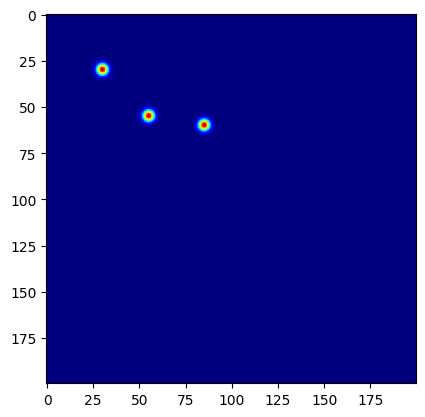

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
sigma=3
h,w = 200,200
ignore_index = 0
offset_label = ignore_index * torch.ones(2, h, w)
x, y = torch.meshgrid(torch.arange(200, dtype=torch.float), torch.arange(200, dtype=torch.float))
center_label = torch.zeros(1, h, w)
canvas = np.zeros((200,200))
points = np.array([[[20,20],[20,40],[40,40],[40,20]],[[50,50],[50,60],[60,60],[60,50]],[[80,50],[80,70],[90,70],[90,50]]])
for i,p in enumerate(points):
    cv2.fillPoly(canvas,[p],i+1)
    instance_mask = (canvas == i+1)
    if instance_mask.sum() == 0:
        # this instance is not in this frame
        prev_xc = None
        prev_yc = None
        prev_mask = None

    xc = x[instance_mask].mean().round().long()
    yc = y[instance_mask].mean().round().long()
    print(xc,yc)
    off_x = xc - x
    off_y = yc - y
    g = torch.exp(-(off_x ** 2 + off_y ** 2) / sigma ** 2)
    center_label[0] = torch.maximum(center_label[0], g)
    offset_label[0, instance_mask] = off_x[instance_mask]
    offset_label[1, instance_mask] = off_y[instance_mask]
plt.imshow(center_label[0].numpy(),cmap=plt.cm.jet)

tensor([ 10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,   9.,
          9.,   9.,   9.,   9.,   9.,   9.,   9.,   9.,   9.,   9.,   8.,   8.,
          8.,   8.,   8.,   8.,   8.,   8.,   8.,   8.,   8.,   7.,   7.,   7.,
          7.,   7.,   7.,   7.,   7.,   7.,   7.,   7.,   6.,   6.,   6.,   6.,
          6.,   6.,   6.,   6.,   6.,   6.,   6.,   5.,   5.,   5.,   5.,   5.,
          5.,   5.,   5.,   5.,   5.,   5.,   4.,   4.,   4.,   4.,   4.,   4.,
          4.,   4.,   4.,   4.,   4.,   3.,   3.,   3.,   3.,   3.,   3.,   3.,
          3.,   3.,   3.,   3.,   2.,   2.,   2.,   2.,   2.,   2.,   2.,   2.,
          2.,   2.,   2.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,
          1.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,  -1.,  -1.,  -1.,  -1.,  -1.,  -1.,  -1.,  -1.,  -1.,  -1.,  -1.,
         -2.,  -2.,  -2.,  -2.,  -2.,  -2.,  -2.,  -2.,  -2.,  -2.,  -2.,  -3.,
         -3.,  -3.,  -3.,  -3.,  -3.,  -

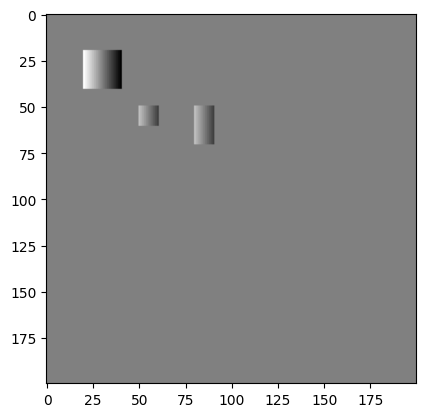

In [3]:
print(offset_label[0, instance_mask])
print(offset_label[0,0:10,0:10])
plt.imshow(offset_label[1].numpy(),cmap='gray')

In [ ]:
device = torch.device('cuda:3')
# cfg1 = get_cfg('/media/user/data4/nuscenes_data/cvt_labels_nuscenes_v5','instance_radar',fuse_in=0,num_classes=12)
# model1, network1, loader1, viz1 = prepare_val(cfg1,device,'../logs/cross_view_transformers_test/0525_040606/checkpoints/last.ckpt')

In [3]:
network1 = network1.to(device)
network1.eval()
img_list = []
with torch.no_grad():
    for i,batch in enumerate(loader1):
#         start = time.time()
        print(i,end='\r')
        for k, v in batch.items():
            if k!='features' or k!='center':
                if isinstance(v, torch.Tensor):
                    batch[k] = v.to(device)
                else:
                    batch[k] = v
        pred = network1(batch)
        raise BaseException
        img_list.append(visualize(batch,pred,instance=True))

torch.Size([1, 128, 25, 25])
torch.Size([6, 128, 25, 25])
torch.Size([1, 6, 128, 25, 25])
torch.Size([1, 128, 25, 25])
torch.Size([6, 128, 25, 25])
torch.Size([1, 6, 128, 25, 25])


BaseException: 

In [6]:
import cv2
for i,img in enumerate(img_list):
    cv2.imwrite('../instance_1/'+ str(i) + '.jpg',img[...,::-1])
# cv2.imshow('My Image', images[0][...,::-1])

# # 按下任意鍵則關閉所有視窗
# cv2.waitKey(0)
# cv2.destroyAllWindows()

In [5]:
vehicle, center, offset = [], [], []
for pred in pred_list:
    vehicle.append(pred['vehicle'].sigmoid())
    center.append(pred['center'])
    offset.append(pred['offset'])
vehicle, center, offset = torch.stack(vehicle)[:,0],torch.stack(center)[:,0],torch.stack(offset)[:,0]
out = {'vehicle':vehicle,'instance_center':center,'instance_offset':offset}
# from cross_view_transformer.data.instance import predict_instance_segmentation_and_trajectories
# instance_out,matched_centers = predict_instance_segmentation_and_trajectories(out,compute_matched_centers=True,threshold=0.5)
# instance_out = predict_instance_segmentation_and_trajectories(out,compute_matched_centers=False,threshold=0.5)

In [5]:
matched_centers

{1: array([[113.       ,   1.8333334]], dtype=float32),
 2: array([[113.36364,   5.     ]], dtype=float32),
 3: array([[113.466675,   8.266667]], dtype=float32),
 4: array([[111.333336,   9.666667]], dtype=float32),
 5: array([[112.66667 ,  10.666667]], dtype=float32),
 6: array([[93.74725 , 30.065935]], dtype=float32),
 7: array([[72., 20.]], dtype=float32),
 8: array([[104.914894, 133.23404 ]], dtype=float32),
 9: array([[ 71.57843, 151.2255 ]], dtype=float32),
 10: array([[ 82.01219, 111.18699]], dtype=float32)}

In [6]:
from cross_view_transformer.data.instance import predict_instance_segmentation_and_trajectories
instance_out = predict_instance_segmentation_and_trajectories(out,threshold=0.5,center_threshold=0.6)

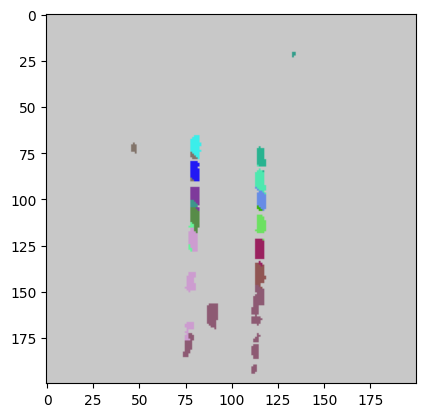

In [60]:
canvas = np.ones((200,200,3)).astype(np.uint8)*200
index = 15
m = instance_out[index,0].max()
color = np.random.choice(range(256), size=(m,3))
for i in range(1,m+1):
    mask = (instance_out[index,0] == i).cpu().numpy()
    canvas[mask] = color[i-1]
plt.imshow(canvas)

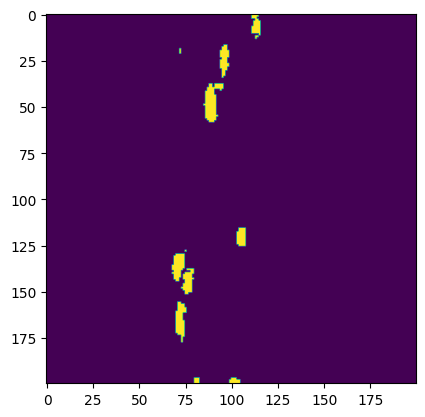

In [7]:
tmp = (vehicle[0,0] > 0.5).long().cpu().numpy()
plt.imshow(tmp)

In [21]:
center.shape

torch.Size([49, 1, 200, 200])

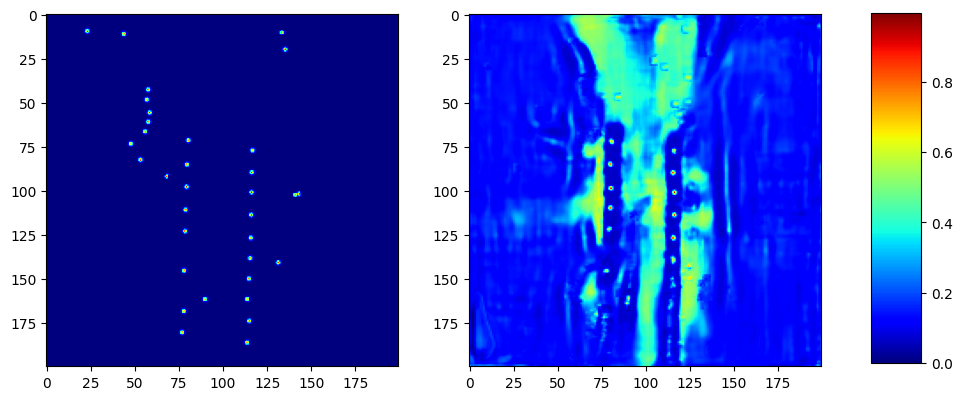

In [26]:
fig, ax = plt.subplots(1,2,figsize=(10,5))
ax[1].imshow(center[15,0].cpu().numpy(),cmap=plt.cm.jet)
img = ax[0].imshow(batch_15['center'][0,0].cpu().numpy(),cmap=plt.cm.jet)
cbar_ax = fig.add_axes([0.95, 0.15, 0.05, 0.7])
fig.colorbar(img,cax=cbar_ax)
plt.show()

In [130]:
import torch
import torch.nn.functional as F
def generate_grid(height: int, width: int):
    xs = torch.linspace(0, 1, width)
    ys = torch.linspace(0, 1, height)

    indices = torch.stack(torch.meshgrid((xs, ys), indexing='xy'), 0)       # 2 h w
    indices = F.pad(indices, (0, 0, 0, 0, 0, 1), value=1)                   # 3 h w
    indices = indices[None]                                                 # 1 3 h w

    return indices

In [8]:
import timm
timm.list_models(pretrained=True)

['bat_resnext26ts.ch_in1k',
 'beit_base_patch16_224.in22k_ft_in22k',
 'beit_base_patch16_224.in22k_ft_in22k_in1k',
 'beit_base_patch16_384.in22k_ft_in22k_in1k',
 'beit_large_patch16_224.in22k_ft_in22k',
 'beit_large_patch16_224.in22k_ft_in22k_in1k',
 'beit_large_patch16_384.in22k_ft_in22k_in1k',
 'beit_large_patch16_512.in22k_ft_in22k_in1k',
 'beitv2_base_patch16_224.in1k_ft_in1k',
 'beitv2_base_patch16_224.in1k_ft_in22k',
 'beitv2_base_patch16_224.in1k_ft_in22k_in1k',
 'beitv2_large_patch16_224.in1k_ft_in1k',
 'beitv2_large_patch16_224.in1k_ft_in22k',
 'beitv2_large_patch16_224.in1k_ft_in22k_in1k',
 'botnet26t_256.c1_in1k',
 'caformer_b36.sail_in1k',
 'caformer_b36.sail_in1k_384',
 'caformer_b36.sail_in22k',
 'caformer_b36.sail_in22k_ft_in1k',
 'caformer_b36.sail_in22k_ft_in1k_384',
 'caformer_m36.sail_in1k',
 'caformer_m36.sail_in1k_384',
 'caformer_m36.sail_in22k',
 'caformer_m36.sail_in22k_ft_in1k',
 'caformer_m36.sail_in22k_ft_in1k_384',
 'caformer_s18.sail_in1k',
 'caformer_s18.s

In [12]:
m = timm.create_model('swinv2_cr_tiny_ns_224.sw_in1k',pretrained=True,img_size=(256,704),features_only=True,out_indices=[0,2])

In [3]:
import matplotlib.pyplot as plt
import tqdm
import numpy as np

from nuscenes.map_expansion.map_api import NuScenesMap
from nuscenes.map_expansion import arcline_path_utils
from nuscenes.map_expansion.bitmap import BitMap

nusc_map = NuScenesMap(dataroot='/media/user/data4/nuscenes_data/', map_name='singapore-onenorth')

In [90]:
center = (int(batch['pose'][0,1,-1].numpy()),int(batch['pose'][0,0,-1].numpy()))
patch_box = (center[0], center[1], 200, 200) # Patch box defined as [x_center, y_center, height, width]
radius = 150
patch = (center[0]-radius,center[1]-radius,center[0]+radius,center[1]+radius)
patch_angle = 0  # Default orientation where North is up
layer_names = ['road_divider', 'lane_divider','lane','road_segment']
canvas_size = (200, 200)
map_mask = nusc_map.get_map_mask(patch_box, patch_angle, layer_names, canvas_size)
map_mask.shape

(4, 200, 200)

(200, 200)


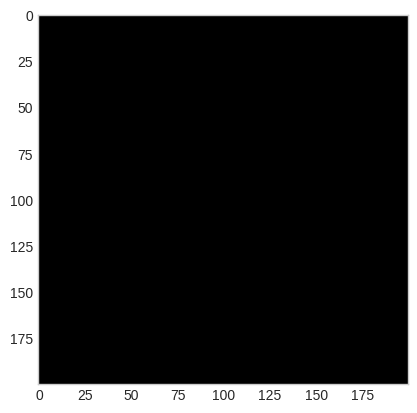

In [89]:
mask = map_mask[2] | map_mask[3]
print(mask.shape)
plt.grid(False)
plt.imshow(mask,cmap='gray')

In [26]:
records_in_patch = nusc_map.get_records_in_patch(patch, layer_names, 'intersect')

In [27]:
records_in_patch[layer_names[1]]

['063187ba-743e-4579-be0d-2d3dfe6d19e6',
 '0c646d44-d46d-46ca-aa7f-806a4f174be8',
 '11943433-927f-4f0c-a560-a9efddc33bc8',
 '158659bb-6339-4470-bb74-5ce8754604d4',
 '3d37fc34-730c-4894-9d8a-6ddbcd2aacbd',
 '5a164381-2d76-46f1-8bda-d5a48e74bc94',
 '5a6e25c9-fbcd-4553-8cd9-72f2cb7b77a9',
 '5e4e576e-0034-407e-ab6b-8347cd84514d',
 '6b5a4771-79b4-4ddf-b305-5f4f8260b6ac',
 '80fedd56-10ee-4109-8519-56c904230158',
 '8b15b1df-4320-4138-8c2c-5454209729f7',
 '8b7c29f5-4d96-4f9d-8d7f-44c8ef4d7261',
 '93abe314-6e9e-44d7-80d3-44a4a96cfbeb',
 '987235be-d7d6-4866-8588-cdc0688034b5',
 'a9298f73-3fe5-4a6f-8b74-9d1ef9bddfd3',
 'b4f64cd5-a398-4850-af8c-63444354ab42',
 'b9bbbad4-2ed4-4b63-8390-9253765c0656',
 'b9e27f67-3f8f-4bfb-a89a-97f489c9a228',
 'bac258e3-0148-4b10-be0d-a1f0fb018212',
 'c0fbd77b-298d-4f9a-b86b-015467845aaf',
 'c8d5936b-8c39-4e21-ac35-8d9d80abc58b']

/home/user/miniconda3/envs/cvt/lib/python3.8/site-packages/descartes/patch.py:63: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  concatenate([asarray(t.exterior)[:, :2]] +


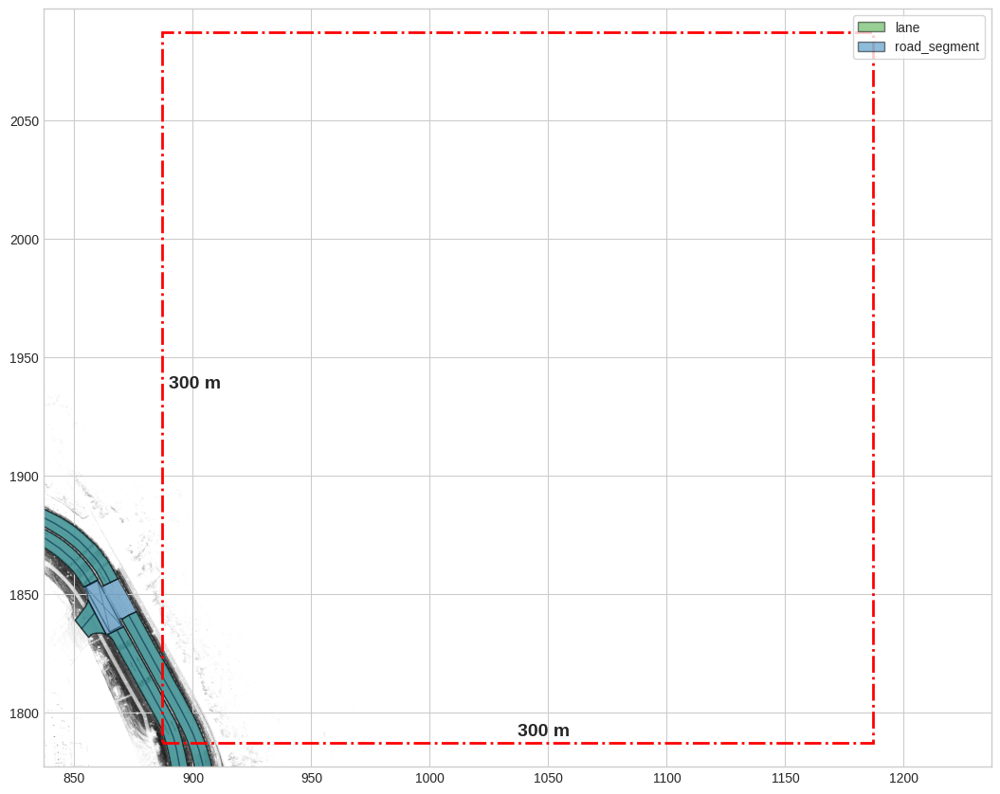

In [91]:
bitmap = BitMap(nusc_map.dataroot, nusc_map.map_name, 'basemap')
# nusc_map.non_geometric_layers
fig, ax = nusc_map.render_map_patch(patch,['lane','road_segment'] , figsize=(10, 10), bitmap=bitmap)

In [51]:
print(batch['pose'][0,0,-1])
print(batch['pose'][0,1,-1])

tensor(1937.3081)
tensor(1037.4747)


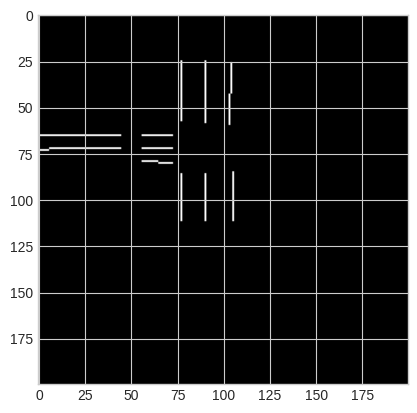

In [70]:
mask_batch = batch['bev'][0,2].type(torch.int32) | batch['bev'][0,3].type(torch.int32)
plt.imshow(mask_batch.cpu().numpy(),cmap='gray')

In [68]:
batch['bev'][0,2].type(torch.int32)

tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]], dtype=torch.int32)

In [82]:
center = (float(batch['pose'][0,0,-1].numpy()),float(batch['pose'][0,1,-1].numpy()))
print((center))

(1937.30810546875, 1037.4747314453125)


In [102]:
sample = nusc.get('sample','3950bd41f74548429c0f7700ff3d8269')
sample

{'token': '3950bd41f74548429c0f7700ff3d8269',
 'timestamp': 1533151604048025,
 'prev': '3e8750f331d7499e9b5123e9eb70f2e2',
 'next': 'c5f58c19249d4137ae063b0e9ecd8b8e',
 'scene_token': 'fcbccedd61424f1b85dcbf8f897f9754',
 'data': {'RADAR_FRONT': '9a468cd8d5af4e0a9bc42b5093627855',
  'RADAR_FRONT_LEFT': '500f88c81a5747b7ae979222f572ed11',
  'RADAR_FRONT_RIGHT': '7d619c18412c47779505ea5d76db3295',
  'RADAR_BACK_LEFT': 'ee8765852c244848b1789f97ea058351',
  'RADAR_BACK_RIGHT': 'a2365cd2f5ed44f784db16a3a7a490fc',
  'LIDAR_TOP': '53121f39e1a0434d8431777a05de3eec',
  'CAM_FRONT': 'ba01f58b926a472b9d146cb5a54e9a2e',
  'CAM_FRONT_RIGHT': '55f48b2af8cd469a9d62c0907c34ff98',
  'CAM_BACK_RIGHT': 'f1adb4995a7f4dbdaa01d6f990ede324',
  'CAM_BACK': '8e55b95c9a884c1e8f4f5fed3d6077e6',
  'CAM_BACK_LEFT': '4595512cdf9e4c468f8451958184f8c7',
  'CAM_FRONT_LEFT': '99c45131864b4a92bad2bad141bff4ae'},
 'anns': ['d08b8c6ecc6b4824aa890ffac8a288a8',
  '9c2cd11180d143b78963ffc0d638af46',
  '311275464f4e49518ce39ef

In [105]:
lidar_top = nusc.get('sample_data',sample['data']['LIDAR_TOP'])
lidar_top

{'token': '53121f39e1a0434d8431777a05de3eec',
 'sample_token': '3950bd41f74548429c0f7700ff3d8269',
 'ego_pose_token': '53121f39e1a0434d8431777a05de3eec',
 'calibrated_sensor_token': 'd051cafdd9fe4d999b413462364d44a0',
 'timestamp': 1533151604048025,
 'fileformat': 'pcd',
 'is_key_frame': True,
 'height': 0,
 'width': 0,
 'filename': 'samples/LIDAR_TOP/n008-2018-08-01-15-16-36-0400__LIDAR_TOP__1533151604048025.pcd.bin',
 'prev': '9d64a4b6538e42d7b7f6a7273a631638',
 'next': '682559101eb0405d84add6e6b5b105cc',
 'sensor_modality': 'lidar',
 'channel': 'LIDAR_TOP'}

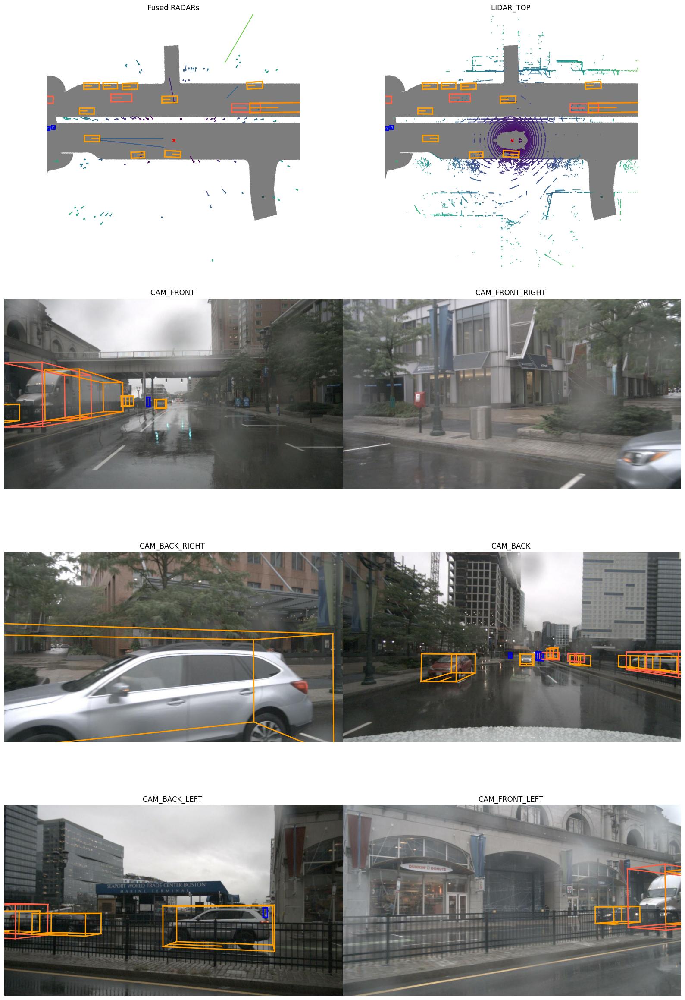

In [50]:
nusc.render_sample(dataset1.__getitem__(4063)['token'])

Downloading: "https://download.pytorch.org/models/deeplabv3_mobilenet_v3_large-fc3c493d.pth" to /home/user/.cache/torch/hub/checkpoints/deeplabv3_mobilenet_v3_large-fc3c493d.pth


  0%|          | 0.00/42.3M [00:00<?, ?B/s]

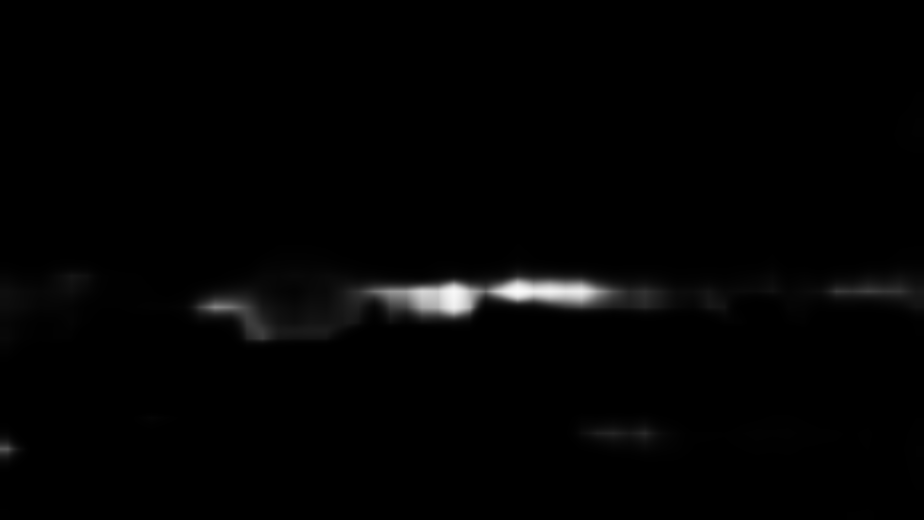

In [24]:
from torchvision.io.image import read_image
from torchvision.models.segmentation import fcn_resnet50, FCN_ResNet50_Weights, lraspp_mobilenet_v3_large, LRASPP_MobileNet_V3_Large_Weights, deeplabv3_mobilenet_v3_large, DeepLabV3_MobileNet_V3_Large_Weights
from torchvision.transforms.functional import to_pil_image

img = read_image('/media/user/data4/nuscenes_data/' + img_path)

# Step 1: Initialize model with the best available weights
weights = DeepLabV3_MobileNet_V3_Large_Weights.DEFAULT
model = deeplabv3_mobilenet_v3_large(weights=weights)
model.eval()

# Step 2: Initialize the inference transforms
preprocess = weights.COCO_WITH_VOC_LABELS_V1.transforms()# weights.transforms()

# Step 3: Apply inference preprocessing transforms
batch = preprocess(img).unsqueeze(0)

# Step 4: Use the model and visualize the prediction
with torch.no_grad():
    prediction = model(batch)["out"]
    normalized_masks = prediction.softmax(dim=1)
    class_to_idx = {cls: idx for (idx, cls) in enumerate(weights.meta["categories"])}
    mask = normalized_masks[0, class_to_idx["car"]]
    display(to_pil_image(mask))

In [5]:
sample = nusc.get('sample',raw[0]['token'][0])
sample_data = nusc.get('sample_data', sample['data']['CAM_FRONT'])
img_path = sample_data['filename']

In [12]:
mask = to_pil_image(mask)

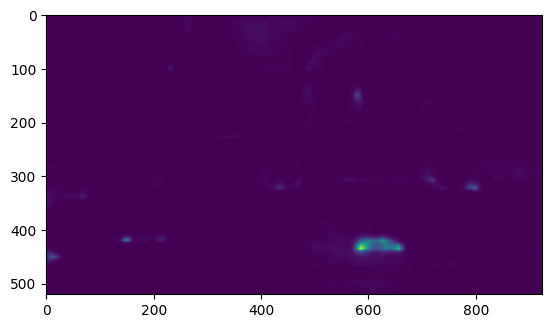

In [9]:
plt.imshow(mask.detach().cpu().numpy())

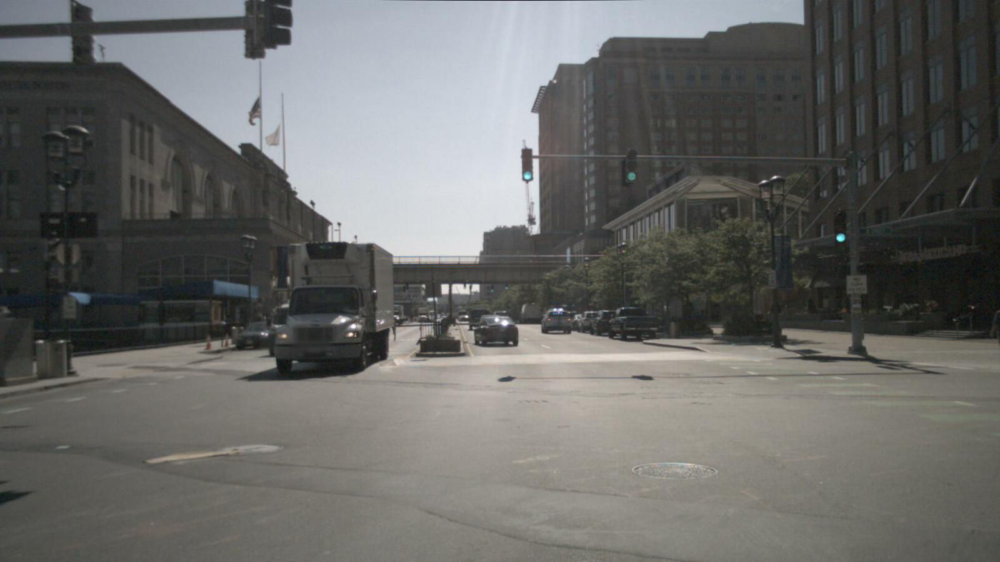

In [22]:
to_pil_image(img)

In [20]:
weights.meta["categories"]

['__background__',
 'aeroplane',
 'bicycle',
 'bird',
 'boat',
 'bottle',
 'bus',
 'car',
 'cat',
 'chair',
 'cow',
 'diningtable',
 'dog',
 'horse',
 'motorbike',
 'person',
 'pottedplant',
 'sheep',
 'sofa',
 'train',
 'tvmonitor']

In [42]:
color = {0:(110, 110, 110),6:(255, 127, 80),7:(255, 158, 0)}
canvas = np.zeros((520,924,3))
pred_mask = normalized_masks[0].argmax(0).cpu().numpy().astype(int)
for k,v in color.items():
    canvas[pred_mask==k] = v
# for i in range(900):
#     for j in range(1600):
#         pred = int(normalized_masks[0].argmax(0)[i,j].cpu().numpy())
#         if pred in color:
#             canvas[i,j] = color[pred]

(520, 924)


In [33]:
img.shape

torch.Size([3, 900, 1600])

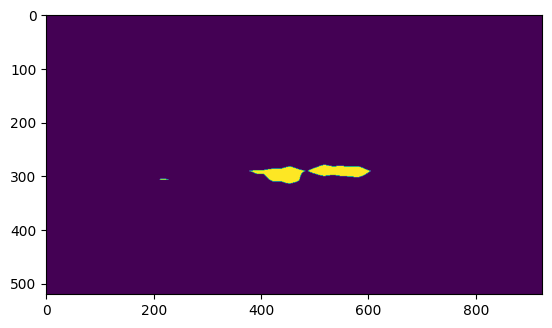

In [44]:
plt.imshow(pred_mask==7)

In [49]:
dataset1.__getitem__(4063)['token']

'f2fb282e13784e7c8a28d0d5e1370ad1'

In [60]:
a = torch.load('/media/user/data2/nuscenes_data/features/CAM_FRONT_LEFT/n008-2018-05-21-11-06-59-0400__CAM_FRONT_LEFT__1526915243004917_pts.pt')
b = torch.nn.functional.interpolate(a[None],(25,25))

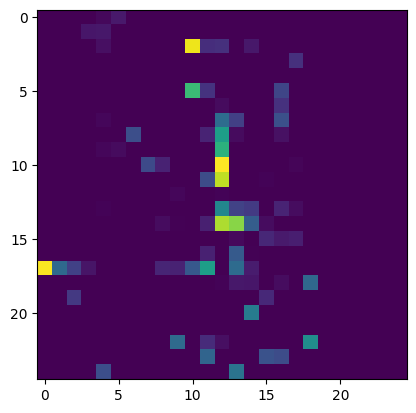

In [65]:
channel = 3
plt.imshow(b[0,channel])

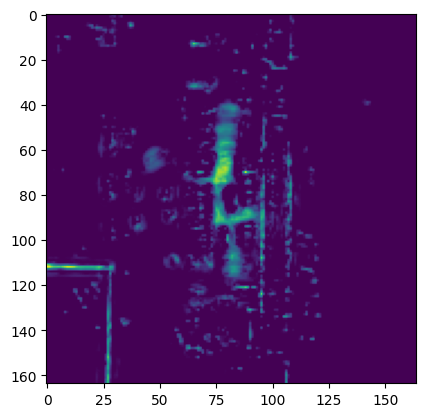

In [66]:
plt.imshow(a[channel])